In [ ]:
#import the librarires
import torch,pdb
from torch.utils.data import DataLoader
from torch import nn
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

In [ ]:
cd

/root


In [ ]:
#visualization function
def show(tensor,ch=1,size=(28,28),num=16):
  #tensor: 128 x 784
  data = tensor.detach().cpu().view(-1,ch,*size) # 128 x 1 x 28 x 28
  grid = make_grid(data[:num],nrow=4).permute(1,2,0) # 16x 1 x 28 x 28 as matplotlib lib uses
  plt.imshow(grid)
  plt.show()

In [ ]:
#set of main parameters and hyperparameters
epochs = 500
cur_step = 0
info_step = 300
mean_gen_loss = 0
mean_disc_loss = 0

z_dim = 64
lr = 0.0001
loss_func = nn.BCEWithLogitsLoss()

bs = 128
device = 'cuda'

dataloader = DataLoader(MNIST('.',download=True,transform=transforms.ToTensor()),shuffle=True,batch_size=bs)



  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw



In [ ]:
#declade our models

#Generator

def genBlock(inp,out):
  return nn.Sequential(
      nn.Linear(inp,out),
      nn.BatchNorm1d(out),
      nn.ReLU(inplace=True)
  )

class Generator(nn.Module):
  def __init__(self,z_dim=64,i_dim=784,h_dim =128):
    super().__init__()
    self.gen = nn.Sequential(
        genBlock(z_dim,h_dim), # 64 x 128
        genBlock(h_dim,2*h_dim),# 128 x256
        genBlock(2*h_dim,4*h_dim),# 256 * 512
        genBlock(4*h_dim,8*h_dim),# 512 x 1024
        nn.Linear(8*h_dim,i_dim) , # 1024 x 784
        nn.Sigmoid()
    )

  def forward(self, noise):
    return self.gen(noise)

def gen_noise(number,z_dim):
  return torch.randn(number,z_dim).to(device)


def discBlock(inp,out):
  return nn.Sequential(
      nn.Linear(inp,out),
      nn.LeakyReLU(0.2)
  )

class Discriminator(nn.Module):
  def __init__(self,i_dim=784,h_dim=256):
    super().__init__()
    self.disc = nn.Sequential(
        discBlock(i_dim,h_dim*4), # 784 x 1024
        discBlock(h_dim*4,h_dim*2), # 1024 x 512
        discBlock(h_dim*2,h_dim), # 512 x 256
        nn.Linear(h_dim, 1) # 256 x 1
    )
  
  def forward(self,image):
    return self.disc(image)


In [ ]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(),lr=lr)
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(),lr=lr)

In [ ]:
gen

Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): Linear(in_features=64, out_features=128, bias=True)
      (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Linear(in_features=128, out_features=256, bias=True)
      (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): Linear(in_features=256, out_features=512, bias=True)
      (1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): Linear(in_features=512, out_features=1024, bias=True)
      (1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (4): Linear(in_features=1024, out_features=784, bias=True)
    (5): Sigmoid()
  )
)

torch.Size([128, 1, 28, 28]) torch.Size([128])
tensor([1, 1, 0, 6, 5, 1, 6, 7, 8, 7])


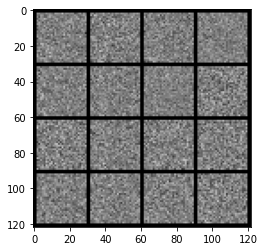

In [ ]:
x,y = next(iter(dataloader))
print(x.shape,y.shape)
print(y[:10])

noise  = gen_noise(bs,z_dim)
fake = gen(noise)
show(fake)

In [ ]:
#calulating the loss

#generator_loss
def calc_gen_loss(loss_func,gen,disc,number,z_dim):
  noise =  gen_noise(number,z_dim)
  fake = gen(noise)
  pred = disc(fake)
  targets = torch.ones_like(pred)
  gen_loss = loss_func(pred, targets)
  return gen_loss

def calc_disc_loss(loss_func,gen,disc,number,real,z_dim):
  noise =  gen_noise(number,z_dim)
  fake = gen(noise)
  disc_fake = disc(fake.detach())
  disc_fake_targets = torch.zeros_like(disc_fake)
  disc_fake_loss = loss_func(disc_fake,disc_fake_targets)

  disc_real = disc(real)
  disc_real_targets = torch.ones_like(disc_real)
  disc_real_loss = loss_func(disc_real,disc_real_targets)

  disc_loss = disc_fake_loss + disc_real_loss
  return disc_loss

  0%|          | 0/469 [00:00<?, ?it/s]

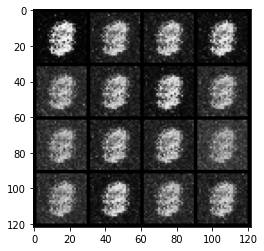

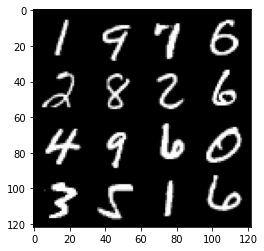

0: step 300 / Gen_loss: 1.8957488101720807 / Disc_loss: 0.6819047709306091


  0%|          | 0/469 [00:00<?, ?it/s]

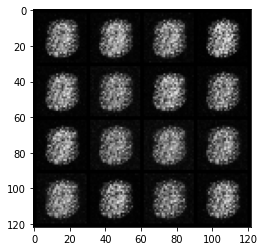

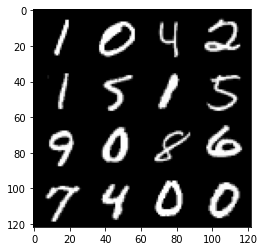

1: step 600 / Gen_loss: 3.3850485221544897 / Disc_loss: 0.24586852500836048


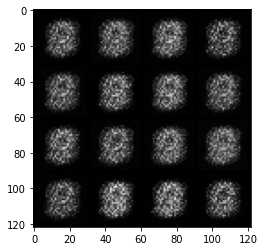

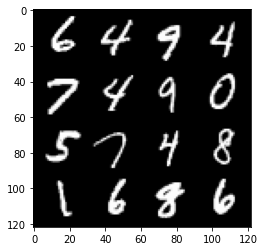

1: step 900 / Gen_loss: 3.3183871388435353 / Disc_loss: 0.12079405595858886


  0%|          | 0/469 [00:00<?, ?it/s]

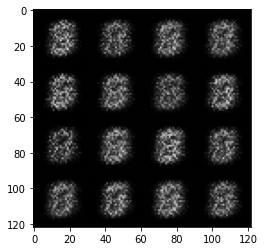

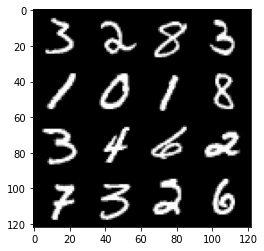

2: step 1200 / Gen_loss: 3.373901108105979 / Disc_loss: 0.08547833497325583


  0%|          | 0/469 [00:00<?, ?it/s]

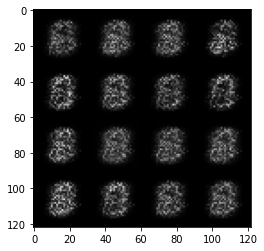

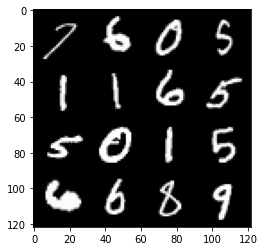

3: step 1500 / Gen_loss: 3.330931951999663 / Disc_loss: 0.08966237102945647


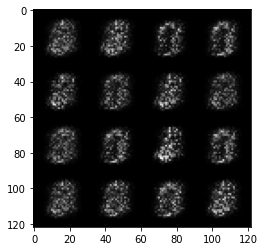

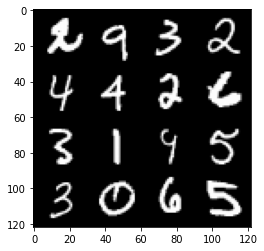

3: step 1800 / Gen_loss: 3.442259764671324 / Disc_loss: 0.09406940585623183


  0%|          | 0/469 [00:00<?, ?it/s]

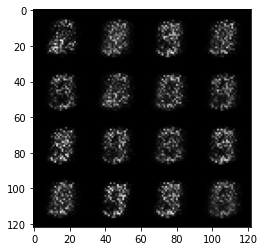

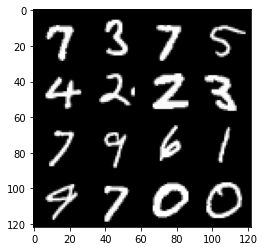

4: step 2100 / Gen_loss: 3.7007663790384955 / Disc_loss: 0.07959118063251179


  0%|          | 0/469 [00:00<?, ?it/s]

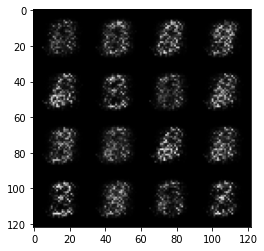

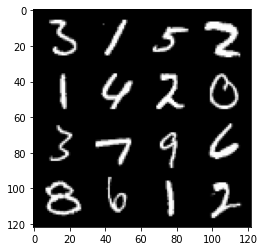

5: step 2400 / Gen_loss: 4.179164203008015 / Disc_loss: 0.05314255107815067


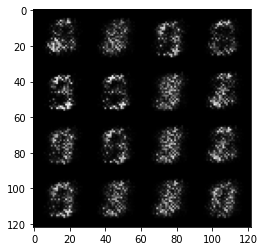

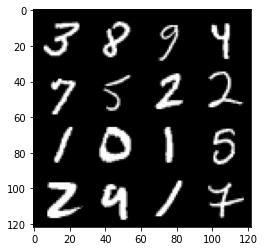

5: step 2700 / Gen_loss: 4.312747716903685 / Disc_loss: 0.05747858385245008


  0%|          | 0/469 [00:00<?, ?it/s]

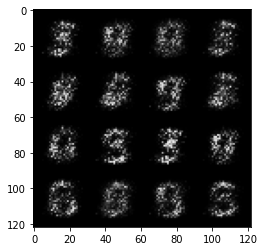

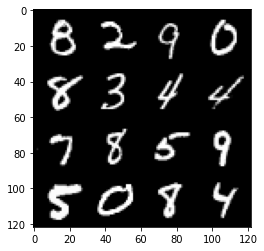

6: step 3000 / Gen_loss: 4.938482327461241 / Disc_loss: 0.04874774933482208


  0%|          | 0/469 [00:00<?, ?it/s]

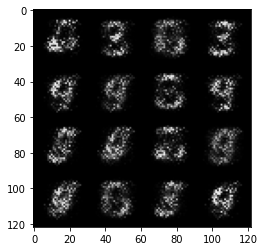

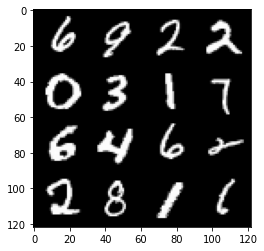

7: step 3300 / Gen_loss: 5.144754621187849 / Disc_loss: 0.04500627725074685


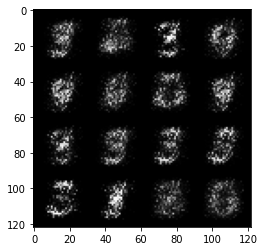

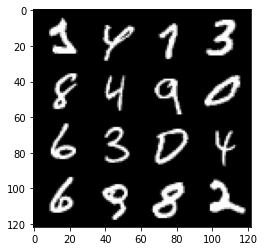

7: step 3600 / Gen_loss: 5.0312409273783345 / Disc_loss: 0.048076887012769756


  0%|          | 0/469 [00:00<?, ?it/s]

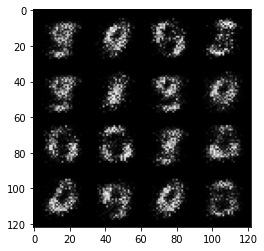

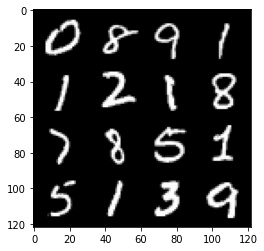

8: step 3900 / Gen_loss: 5.4278843609491965 / Disc_loss: 0.0480759086832404


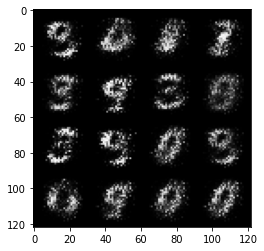

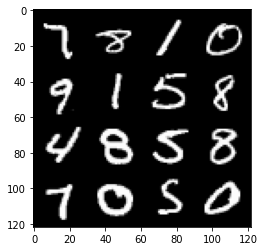

8: step 4200 / Gen_loss: 5.920691421826686 / Disc_loss: 0.044767748744537435


  0%|          | 0/469 [00:00<?, ?it/s]

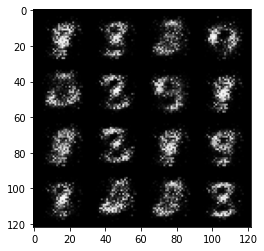

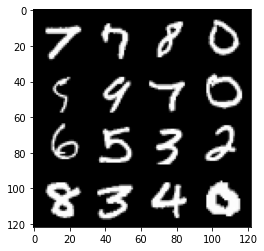

9: step 4500 / Gen_loss: 5.817850027084351 / Disc_loss: 0.04331240347276127


  0%|          | 0/469 [00:00<?, ?it/s]

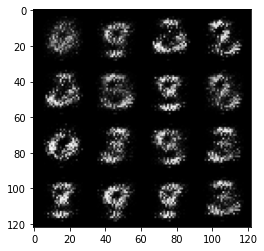

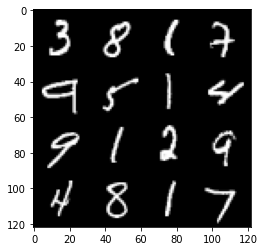

10: step 4800 / Gen_loss: 5.947760217984515 / Disc_loss: 0.033919216198846684


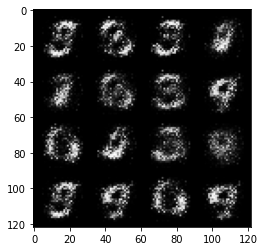

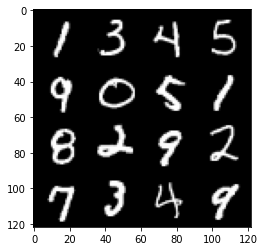

10: step 5100 / Gen_loss: 6.3005762704213435 / Disc_loss: 0.027522727902978654


  0%|          | 0/469 [00:00<?, ?it/s]

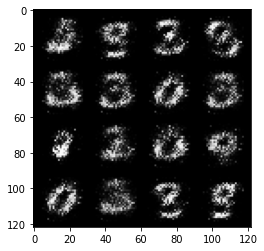

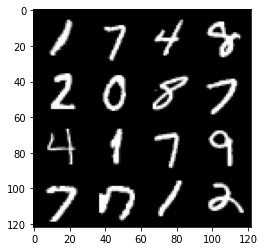

11: step 5400 / Gen_loss: 6.511534825960793 / Disc_loss: 0.023330291351303458


  0%|          | 0/469 [00:00<?, ?it/s]

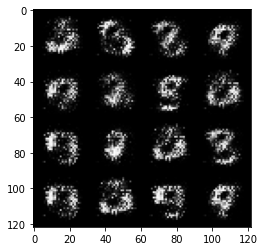

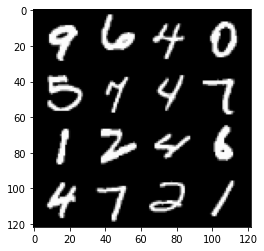

12: step 5700 / Gen_loss: 6.515641105969746 / Disc_loss: 0.022347845610541595


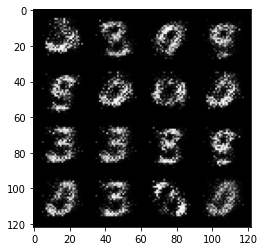

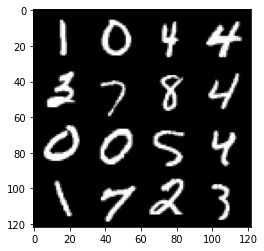

12: step 6000 / Gen_loss: 6.7418138297398915 / Disc_loss: 0.01789302696318677


  0%|          | 0/469 [00:00<?, ?it/s]

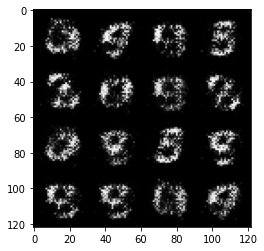

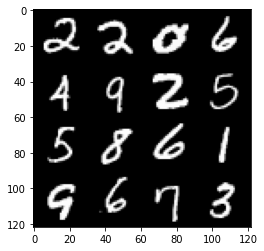

13: step 6300 / Gen_loss: 6.744612935384115 / Disc_loss: 0.019260191493667634


  0%|          | 0/469 [00:00<?, ?it/s]

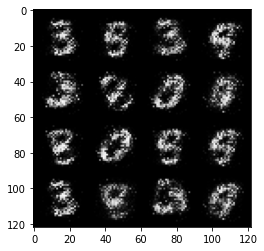

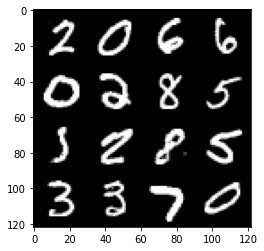

14: step 6600 / Gen_loss: 7.283929899533592 / Disc_loss: 0.01904242732717345


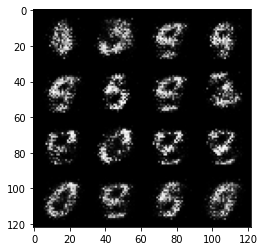

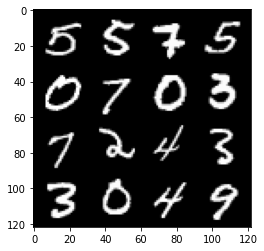

14: step 6900 / Gen_loss: 7.498389140764873 / Disc_loss: 0.026595132372652496


  0%|          | 0/469 [00:00<?, ?it/s]

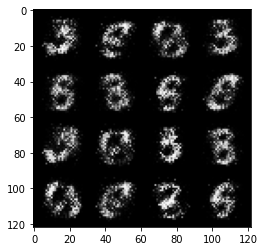

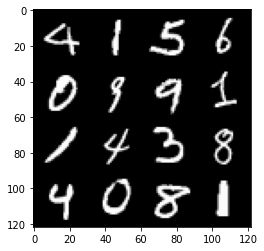

15: step 7200 / Gen_loss: 6.905141674677533 / Disc_loss: 0.03396520209188263


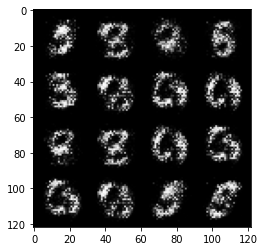

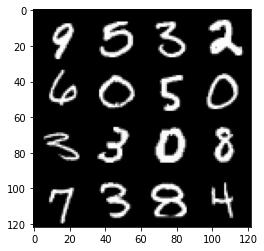

15: step 7500 / Gen_loss: 6.79947794278463 / Disc_loss: 0.028304412188008447


  0%|          | 0/469 [00:00<?, ?it/s]

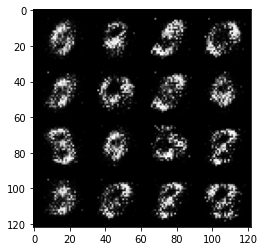

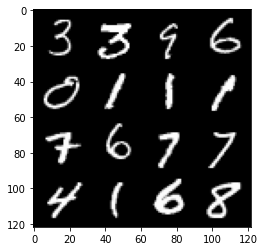

16: step 7800 / Gen_loss: 6.883005498250327 / Disc_loss: 0.021638425166408223


  0%|          | 0/469 [00:00<?, ?it/s]

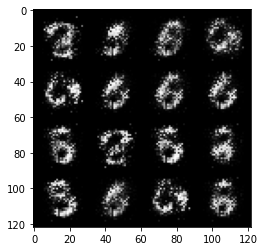

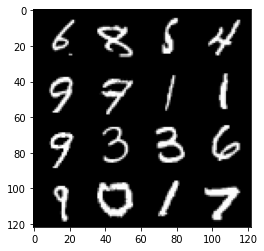

17: step 8100 / Gen_loss: 8.03555588086446 / Disc_loss: 0.02375886235386134


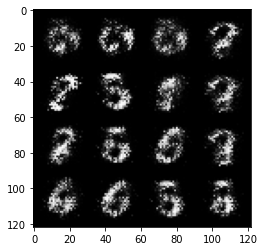

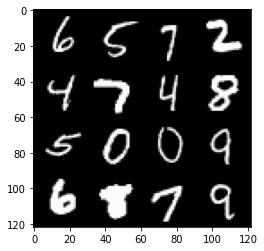

17: step 8400 / Gen_loss: 8.016707359949745 / Disc_loss: 0.024329848738076792


  0%|          | 0/469 [00:00<?, ?it/s]

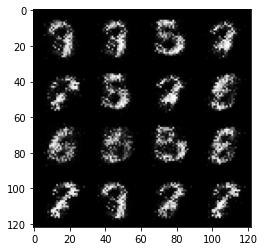

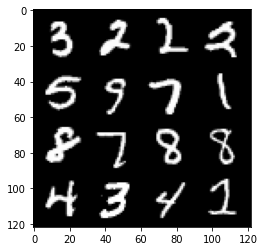

18: step 8700 / Gen_loss: 7.342313167254135 / Disc_loss: 0.026975156043966615


  0%|          | 0/469 [00:00<?, ?it/s]

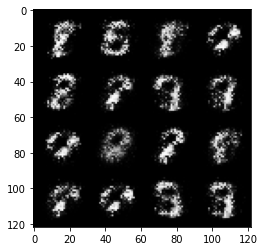

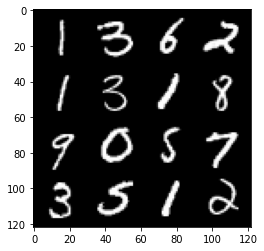

19: step 9000 / Gen_loss: 6.875312913258868 / Disc_loss: 0.024649663926102208


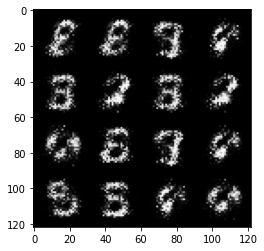

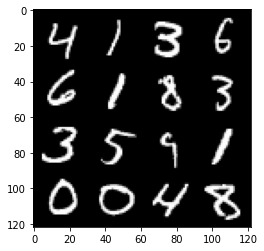

19: step 9300 / Gen_loss: 6.86665679931641 / Disc_loss: 0.022381717469543212


  0%|          | 0/469 [00:00<?, ?it/s]

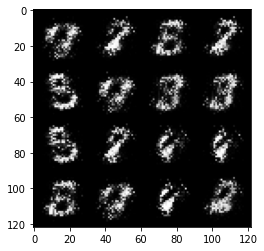

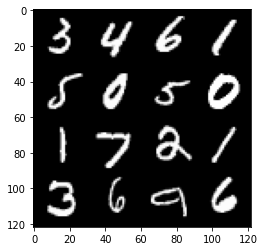

20: step 9600 / Gen_loss: 7.179668146769208 / Disc_loss: 0.017874723650359862


  0%|          | 0/469 [00:00<?, ?it/s]

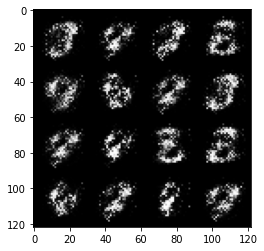

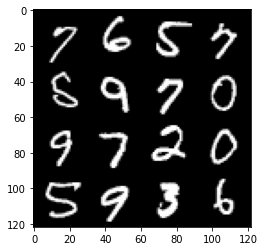

21: step 9900 / Gen_loss: 7.599347503979996 / Disc_loss: 0.015219177782225115


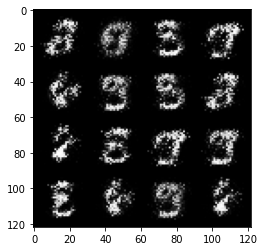

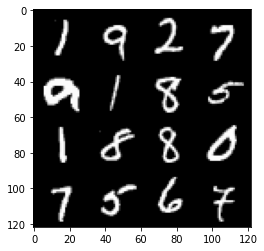

21: step 10200 / Gen_loss: 7.672662040392558 / Disc_loss: 0.015018670831341311


  0%|          | 0/469 [00:00<?, ?it/s]

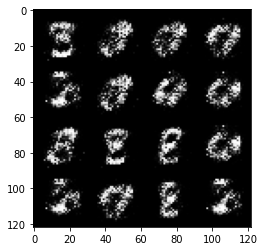

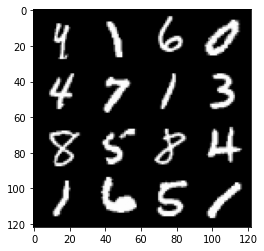

22: step 10500 / Gen_loss: 7.582853949864709 / Disc_loss: 0.014541153898462647


  0%|          | 0/469 [00:00<?, ?it/s]

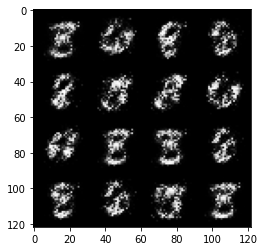

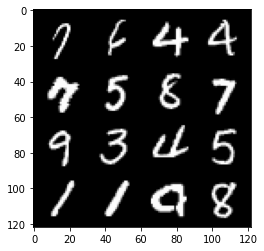

23: step 10800 / Gen_loss: 7.387556406656905 / Disc_loss: 0.01877137194465225


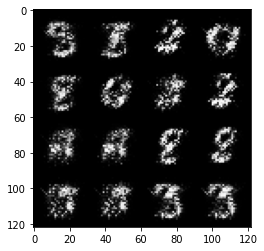

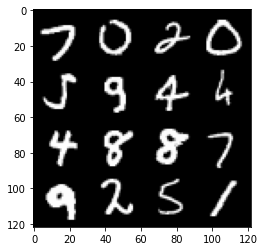

23: step 11100 / Gen_loss: 7.21553796450297 / Disc_loss: 0.018012321197117383


  0%|          | 0/469 [00:00<?, ?it/s]

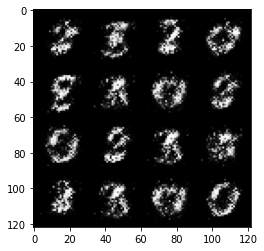

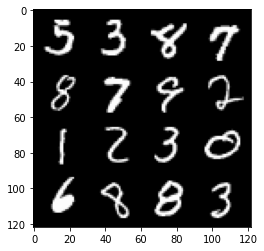

24: step 11400 / Gen_loss: 7.1977318445841485 / Disc_loss: 0.023662082483836767


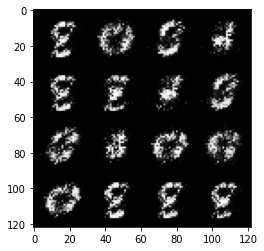

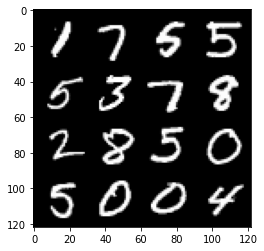

24: step 11700 / Gen_loss: 7.3079805660247805 / Disc_loss: 0.024598479620957122


  0%|          | 0/469 [00:00<?, ?it/s]

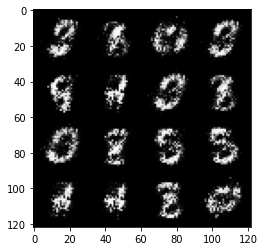

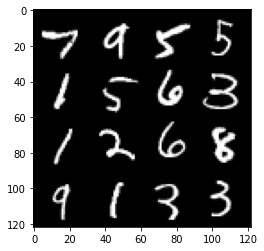

25: step 12000 / Gen_loss: 7.055239777565006 / Disc_loss: 0.022761749372196705


  0%|          | 0/469 [00:00<?, ?it/s]

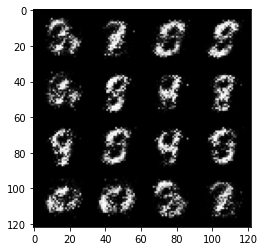

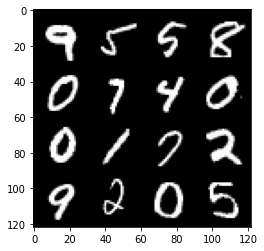

26: step 12300 / Gen_loss: 7.386545631090796 / Disc_loss: 0.024972622157074527


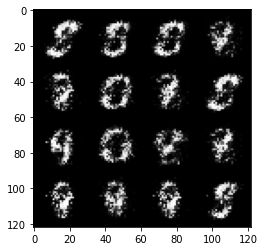

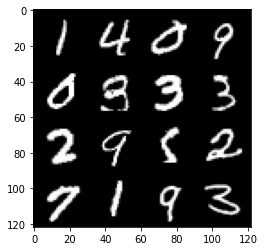

26: step 12600 / Gen_loss: 7.564121149381005 / Disc_loss: 0.022570432634092853


  0%|          | 0/469 [00:00<?, ?it/s]

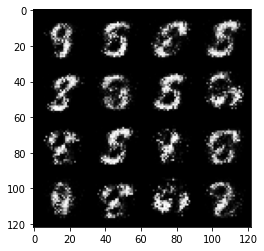

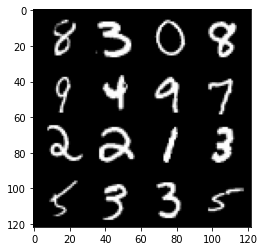

27: step 12900 / Gen_loss: 7.358847920099897 / Disc_loss: 0.02860293791629373


  0%|          | 0/469 [00:00<?, ?it/s]

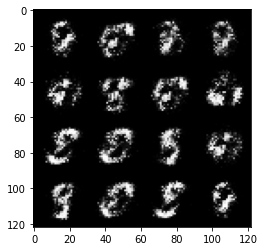

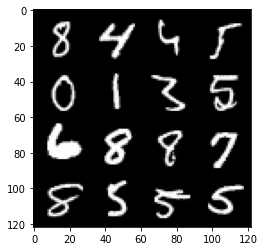

28: step 13200 / Gen_loss: 7.181116673151649 / Disc_loss: 0.03550166080084938


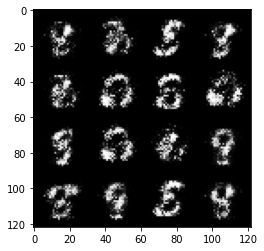

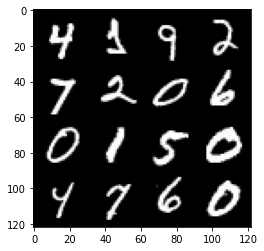

28: step 13500 / Gen_loss: 7.151215399106348 / Disc_loss: 0.032884407970122986


  0%|          | 0/469 [00:00<?, ?it/s]

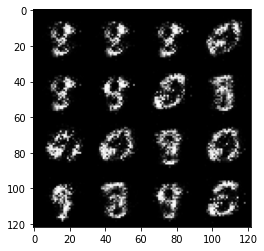

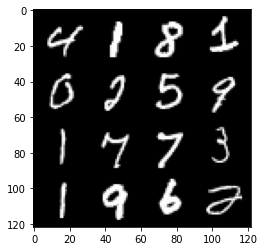

29: step 13800 / Gen_loss: 6.740293385187783 / Disc_loss: 0.029056311597426734


  0%|          | 0/469 [00:00<?, ?it/s]

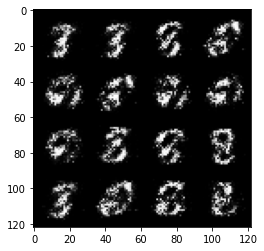

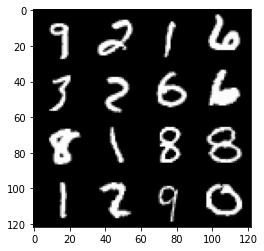

30: step 14100 / Gen_loss: 6.8697924804687505 / Disc_loss: 0.026808848511427657


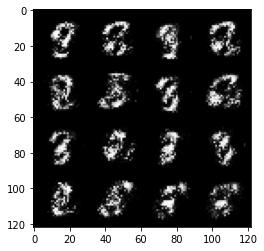

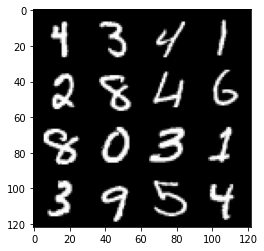

30: step 14400 / Gen_loss: 7.1294769986470525 / Disc_loss: 0.032268185925980394


  0%|          | 0/469 [00:00<?, ?it/s]

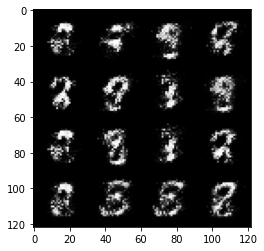

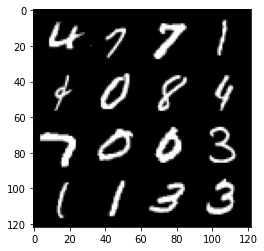

31: step 14700 / Gen_loss: 6.448822790781663 / Disc_loss: 0.042311756409083814


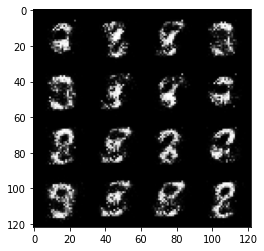

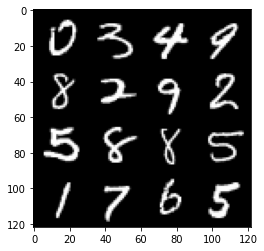

31: step 15000 / Gen_loss: 6.3104727824529006 / Disc_loss: 0.04923076622188095


  0%|          | 0/469 [00:00<?, ?it/s]

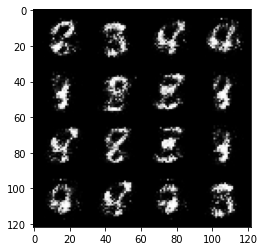

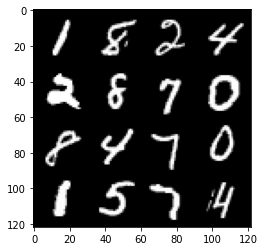

32: step 15300 / Gen_loss: 6.103545762697853 / Disc_loss: 0.05134080117878816


  0%|          | 0/469 [00:00<?, ?it/s]

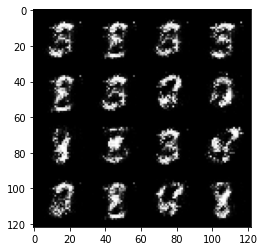

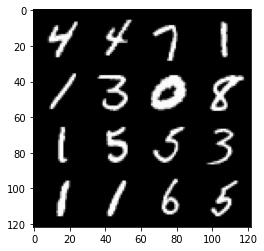

33: step 15600 / Gen_loss: 5.988078114191688 / Disc_loss: 0.047309724849959156


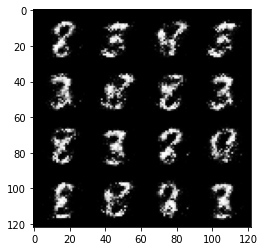

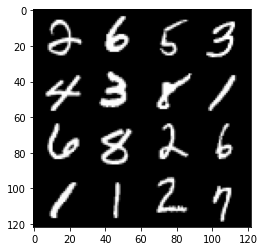

33: step 15900 / Gen_loss: 6.36259265422821 / Disc_loss: 0.040959123295421396


  0%|          | 0/469 [00:00<?, ?it/s]

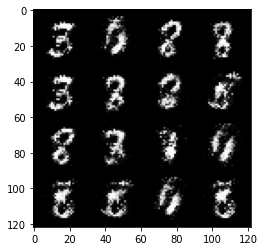

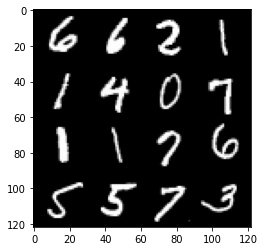

34: step 16200 / Gen_loss: 6.302128221193955 / Disc_loss: 0.04678639288991689


  0%|          | 0/469 [00:00<?, ?it/s]

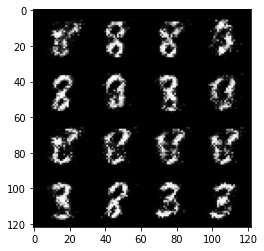

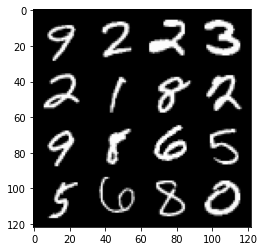

35: step 16500 / Gen_loss: 6.516141942342129 / Disc_loss: 0.045423585847020144


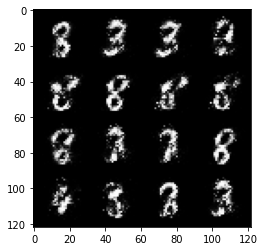

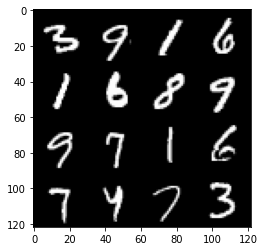

35: step 16800 / Gen_loss: 6.471301042238873 / Disc_loss: 0.054263455697024864


  0%|          | 0/469 [00:00<?, ?it/s]

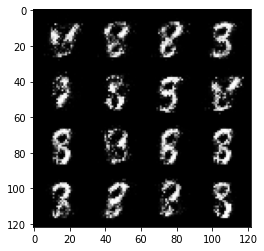

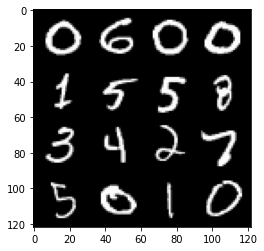

36: step 17100 / Gen_loss: 6.133313301404321 / Disc_loss: 0.06034913674617807


  0%|          | 0/469 [00:00<?, ?it/s]

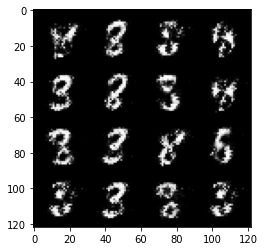

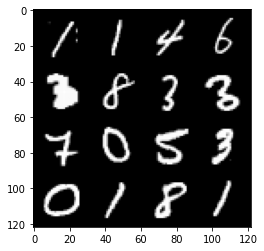

37: step 17400 / Gen_loss: 5.887212998072309 / Disc_loss: 0.06333121224927403


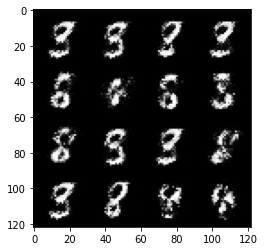

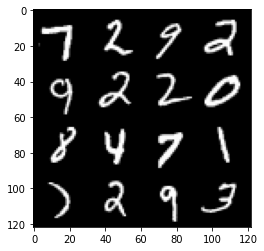

37: step 17700 / Gen_loss: 5.957071318626403 / Disc_loss: 0.060943983634933856


  0%|          | 0/469 [00:00<?, ?it/s]

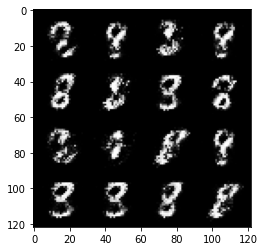

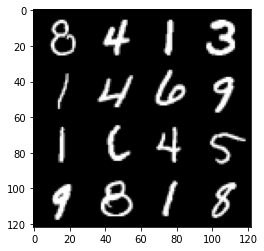

38: step 18000 / Gen_loss: 5.81790888945262 / Disc_loss: 0.0588071374346813


  0%|          | 0/469 [00:00<?, ?it/s]

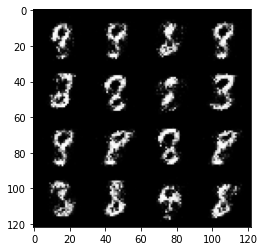

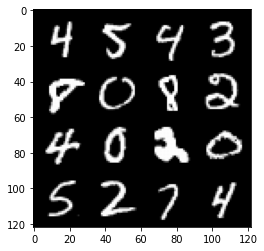

39: step 18300 / Gen_loss: 5.743384950955707 / Disc_loss: 0.06488273499843977


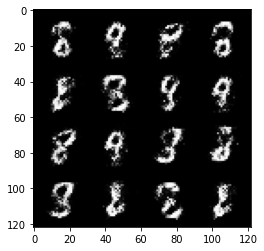

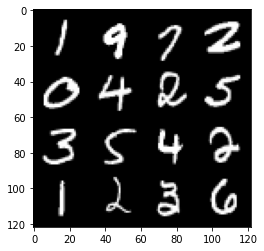

39: step 18600 / Gen_loss: 6.074622038205464 / Disc_loss: 0.059016042460377026


  0%|          | 0/469 [00:00<?, ?it/s]

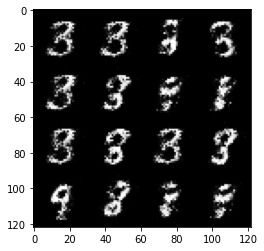

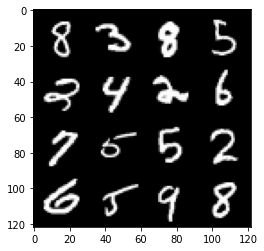

40: step 18900 / Gen_loss: 5.649339084625247 / Disc_loss: 0.061316368912036213


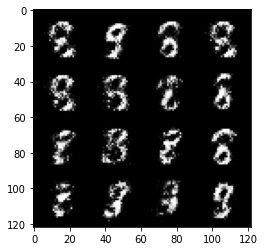

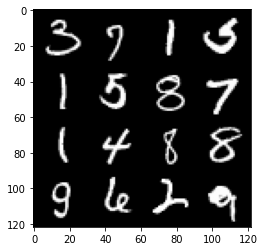

40: step 19200 / Gen_loss: 5.671642665863031 / Disc_loss: 0.06864184535108507


  0%|          | 0/469 [00:00<?, ?it/s]

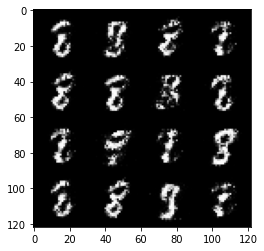

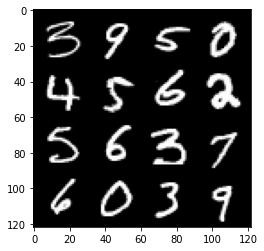

41: step 19500 / Gen_loss: 5.3535948006312015 / Disc_loss: 0.0747380542879304


  0%|          | 0/469 [00:00<?, ?it/s]

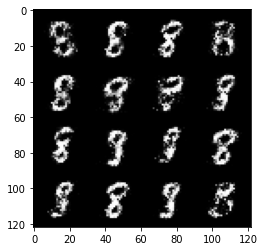

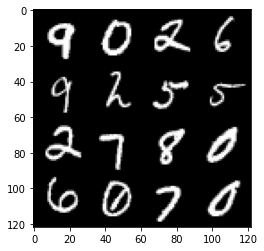

42: step 19800 / Gen_loss: 5.493482081095374 / Disc_loss: 0.07059823146089916


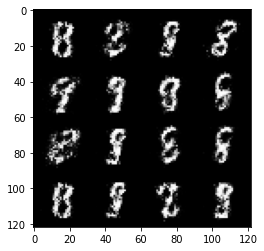

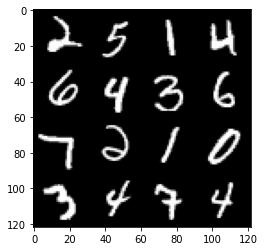

42: step 20100 / Gen_loss: 5.950067791938785 / Disc_loss: 0.079989243298769


  0%|          | 0/469 [00:00<?, ?it/s]

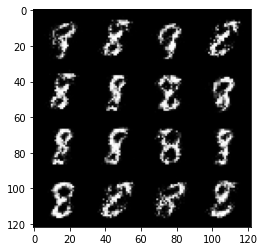

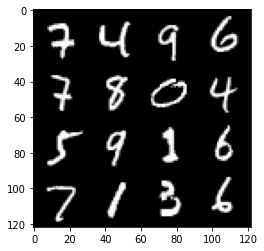

43: step 20400 / Gen_loss: 5.639391573270164 / Disc_loss: 0.08917651470750572


  0%|          | 0/469 [00:00<?, ?it/s]

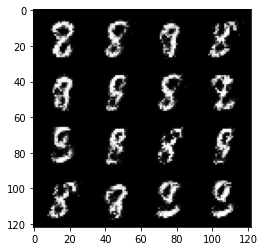

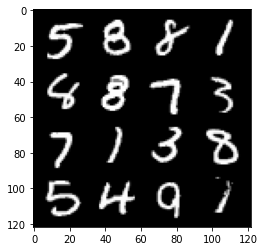

44: step 20700 / Gen_loss: 5.370220287640888 / Disc_loss: 0.09435029939437894


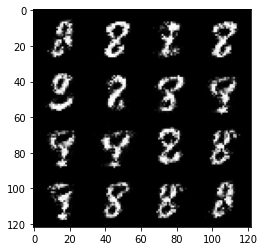

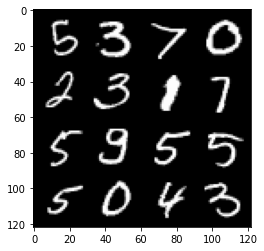

44: step 21000 / Gen_loss: 5.691854764620464 / Disc_loss: 0.08885895848895109


  0%|          | 0/469 [00:00<?, ?it/s]

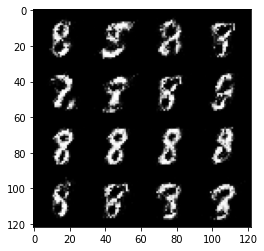

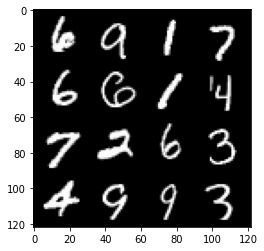

45: step 21300 / Gen_loss: 5.697065203984576 / Disc_loss: 0.09640896515299872


  0%|          | 0/469 [00:00<?, ?it/s]

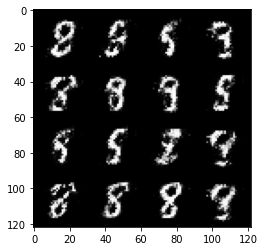

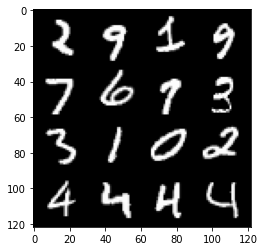

46: step 21600 / Gen_loss: 5.61349203268687 / Disc_loss: 0.08863073399911323


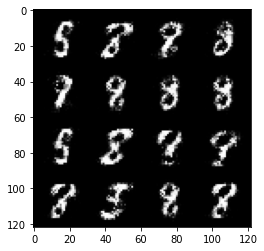

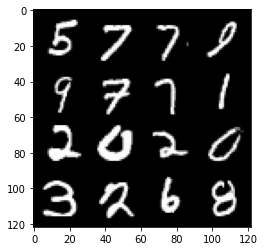

46: step 21900 / Gen_loss: 5.695743029912313 / Disc_loss: 0.09866599391524981


  0%|          | 0/469 [00:00<?, ?it/s]

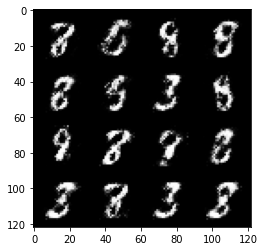

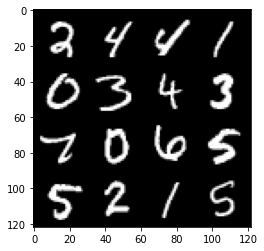

47: step 22200 / Gen_loss: 5.313907510439555 / Disc_loss: 0.11818185351788994


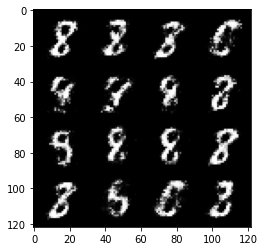

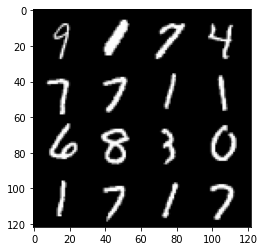

47: step 22500 / Gen_loss: 5.305677979787192 / Disc_loss: 0.12703128060946875


  0%|          | 0/469 [00:00<?, ?it/s]

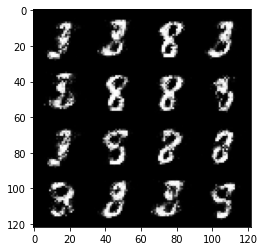

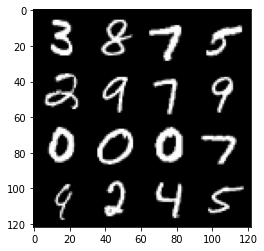

48: step 22800 / Gen_loss: 5.214405633608497 / Disc_loss: 0.09497547319158914


  0%|          | 0/469 [00:00<?, ?it/s]

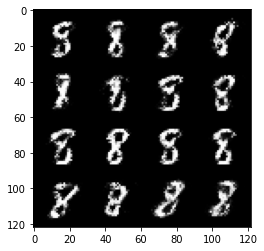

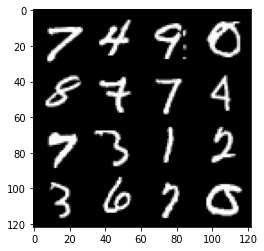

49: step 23100 / Gen_loss: 5.159589307308194 / Disc_loss: 0.11334632127856209


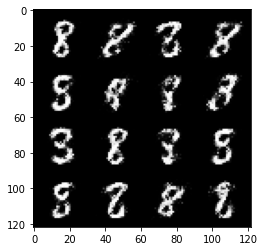

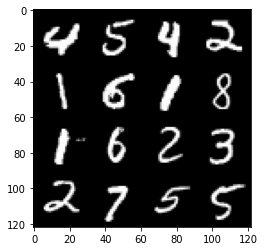

49: step 23400 / Gen_loss: 5.104128473599751 / Disc_loss: 0.1363531979545951


  0%|          | 0/469 [00:00<?, ?it/s]

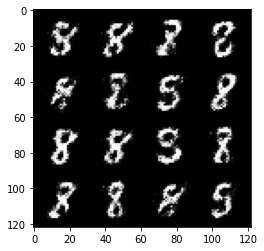

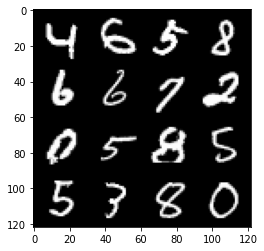

50: step 23700 / Gen_loss: 4.975382983684538 / Disc_loss: 0.13557844039673603


  0%|          | 0/469 [00:00<?, ?it/s]

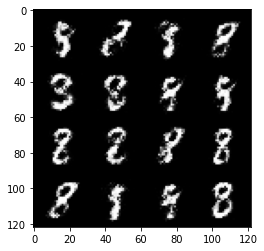

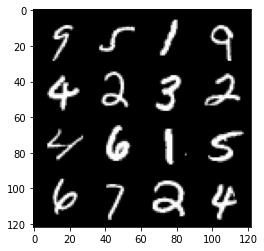

51: step 24000 / Gen_loss: 5.142173786163335 / Disc_loss: 0.11368153831611079


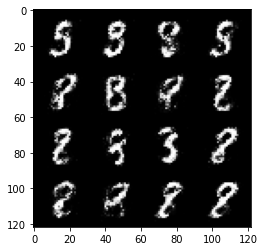

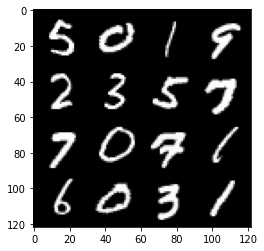

51: step 24300 / Gen_loss: 5.177164808909097 / Disc_loss: 0.1387817296944558


  0%|          | 0/469 [00:00<?, ?it/s]

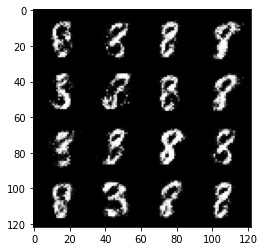

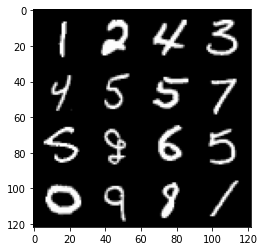

52: step 24600 / Gen_loss: 4.758126459916434 / Disc_loss: 0.16118954988817355


  0%|          | 0/469 [00:00<?, ?it/s]

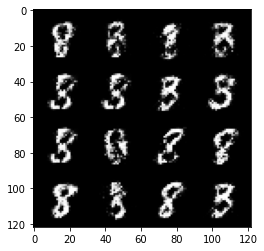

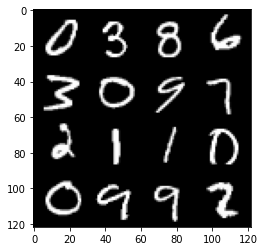

53: step 24900 / Gen_loss: 4.665284472306567 / Disc_loss: 0.14878903248657774


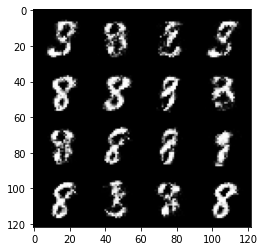

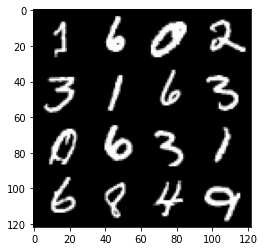

53: step 25200 / Gen_loss: 4.901022670269012 / Disc_loss: 0.15437970905254292


  0%|          | 0/469 [00:00<?, ?it/s]

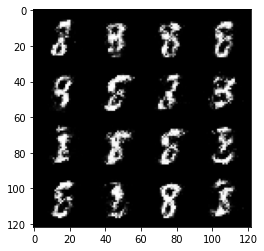

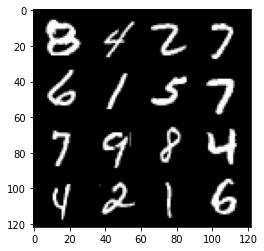

54: step 25500 / Gen_loss: 5.085220246315006 / Disc_loss: 0.1440287692720691


  0%|          | 0/469 [00:00<?, ?it/s]

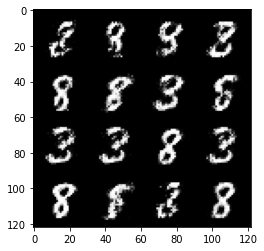

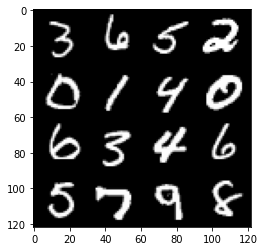

55: step 25800 / Gen_loss: 4.957991534868877 / Disc_loss: 0.15300239770362775


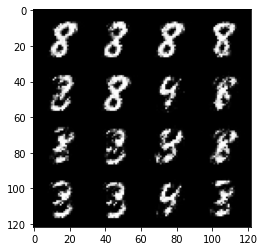

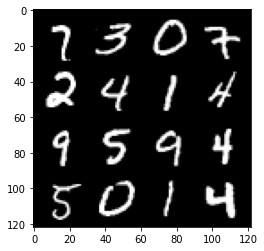

55: step 26100 / Gen_loss: 4.864850413004557 / Disc_loss: 0.16537903455396502


  0%|          | 0/469 [00:00<?, ?it/s]

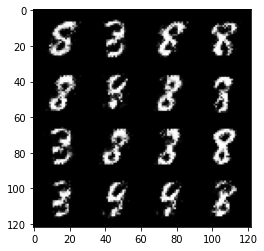

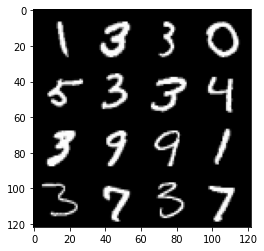

56: step 26400 / Gen_loss: 4.738552186489107 / Disc_loss: 0.1719447114691138


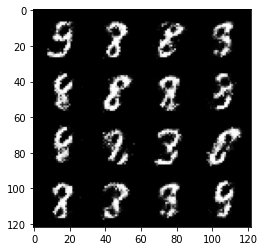

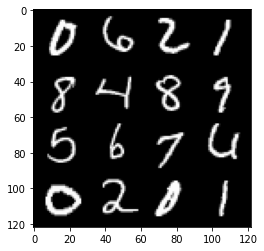

56: step 26700 / Gen_loss: 4.574863417943318 / Disc_loss: 0.18819373394052183


  0%|          | 0/469 [00:00<?, ?it/s]

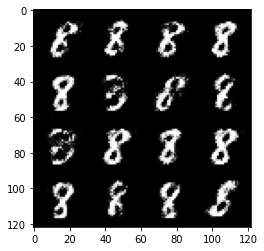

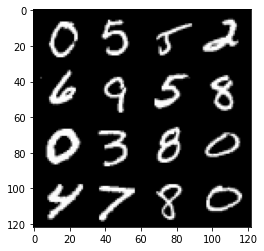

57: step 27000 / Gen_loss: 4.455821134249369 / Disc_loss: 0.19363367003699153


  0%|          | 0/469 [00:00<?, ?it/s]

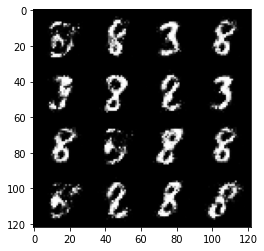

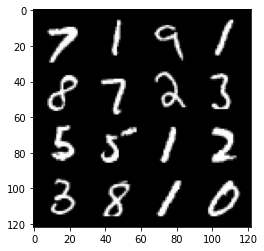

58: step 27300 / Gen_loss: 4.616726911862692 / Disc_loss: 0.17346771006782846


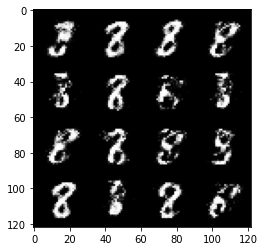

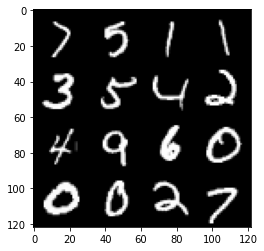

58: step 27600 / Gen_loss: 4.6024414110183764 / Disc_loss: 0.1790370881805818


  0%|          | 0/469 [00:00<?, ?it/s]

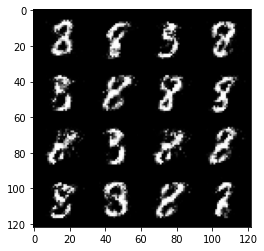

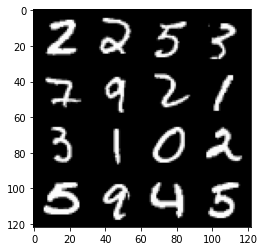

59: step 27900 / Gen_loss: 4.40904654343923 / Disc_loss: 0.18912780414024988


  0%|          | 0/469 [00:00<?, ?it/s]

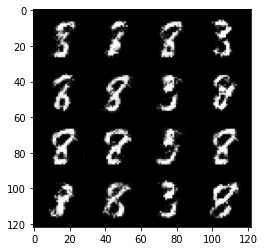

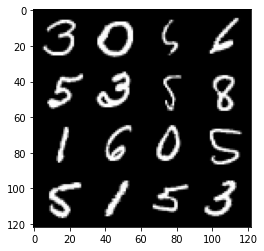

60: step 28200 / Gen_loss: 4.295336357752482 / Disc_loss: 0.20572955973446372


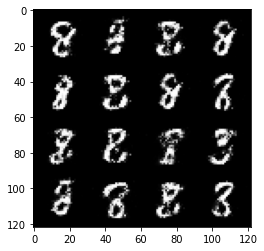

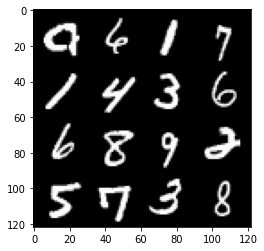

60: step 28500 / Gen_loss: 4.3791236774126645 / Disc_loss: 0.2030965956797203


  0%|          | 0/469 [00:00<?, ?it/s]

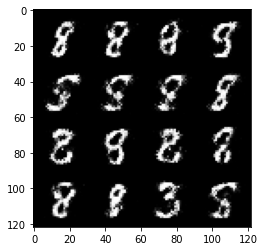

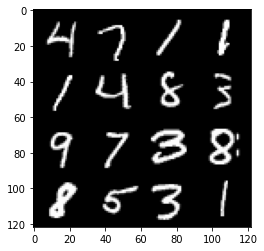

61: step 28800 / Gen_loss: 4.502904373009998 / Disc_loss: 0.19376329230765485


  0%|          | 0/469 [00:00<?, ?it/s]

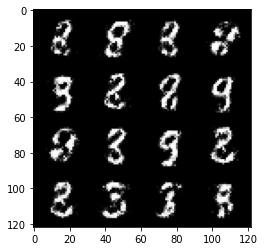

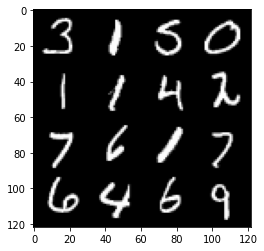

62: step 29100 / Gen_loss: 4.488810900847116 / Disc_loss: 0.179723386876285


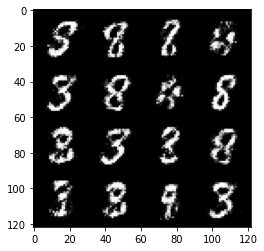

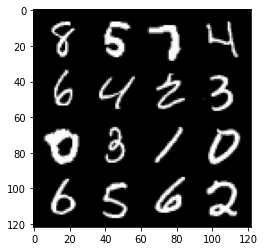

62: step 29400 / Gen_loss: 4.357800649007163 / Disc_loss: 0.18726481854915614


  0%|          | 0/469 [00:00<?, ?it/s]

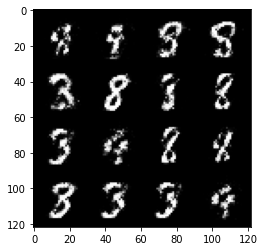

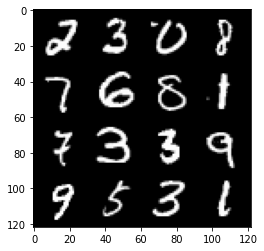

63: step 29700 / Gen_loss: 4.5968753123283435 / Disc_loss: 0.16747816890478132


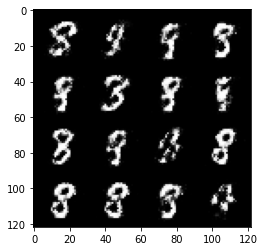

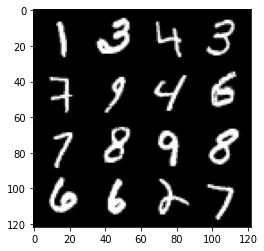

63: step 30000 / Gen_loss: 4.256850839455925 / Disc_loss: 0.21273991875350473


  0%|          | 0/469 [00:00<?, ?it/s]

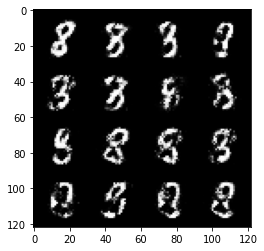

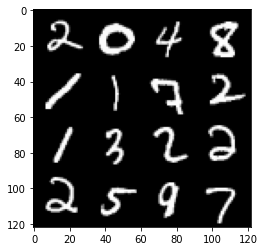

64: step 30300 / Gen_loss: 4.1829587411880516 / Disc_loss: 0.2096674485007921


  0%|          | 0/469 [00:00<?, ?it/s]

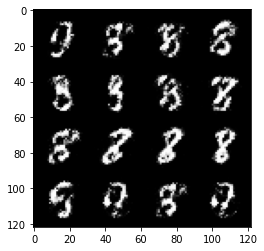

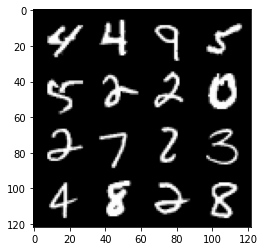

65: step 30600 / Gen_loss: 4.211226301987965 / Disc_loss: 0.2225533453126748


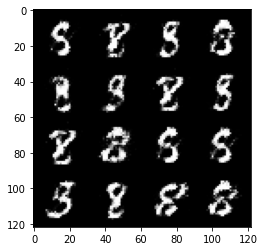

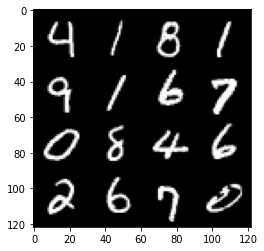

65: step 30900 / Gen_loss: 4.307093833287556 / Disc_loss: 0.22482631780207168


  0%|          | 0/469 [00:00<?, ?it/s]

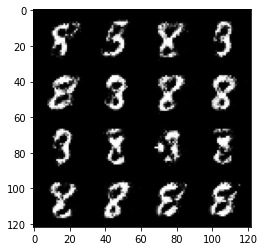

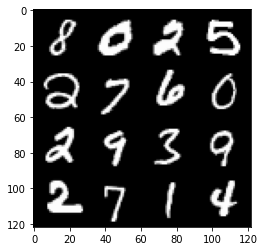

66: step 31200 / Gen_loss: 4.150098776817321 / Disc_loss: 0.21319851579765486


  0%|          | 0/469 [00:00<?, ?it/s]

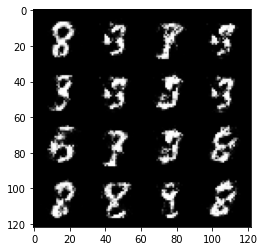

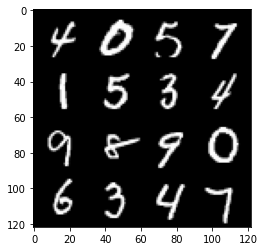

67: step 31500 / Gen_loss: 4.151840538978573 / Disc_loss: 0.21093609941502423


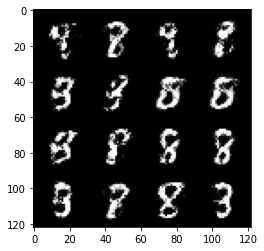

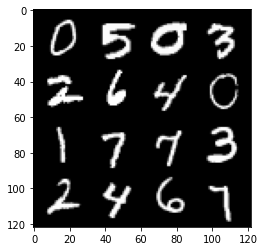

67: step 31800 / Gen_loss: 4.28924072106679 / Disc_loss: 0.2083955981334051


  0%|          | 0/469 [00:00<?, ?it/s]

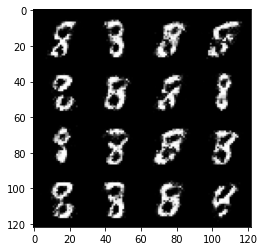

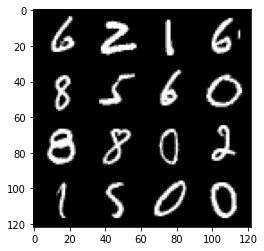

68: step 32100 / Gen_loss: 4.120693220297493 / Disc_loss: 0.2282923237482707


  0%|          | 0/469 [00:00<?, ?it/s]

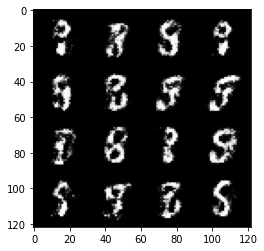

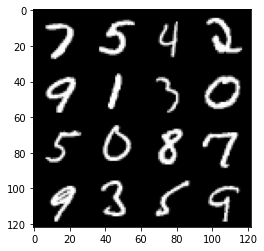

69: step 32400 / Gen_loss: 4.0572389006614715 / Disc_loss: 0.2409608300278586


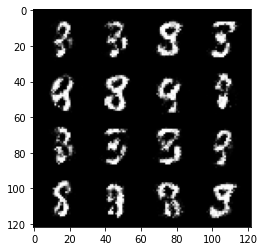

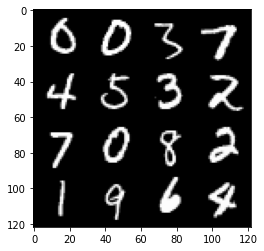

69: step 32700 / Gen_loss: 4.277479542096454 / Disc_loss: 0.2489463885128498


  0%|          | 0/469 [00:00<?, ?it/s]

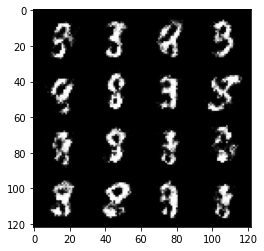

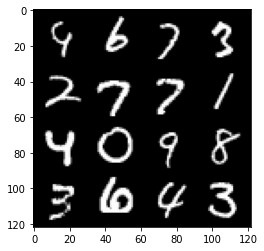

70: step 33000 / Gen_loss: 4.160684582392374 / Disc_loss: 0.24620949832101677


  0%|          | 0/469 [00:00<?, ?it/s]

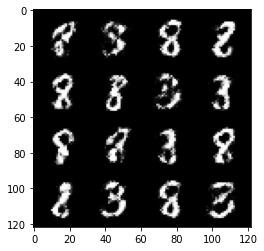

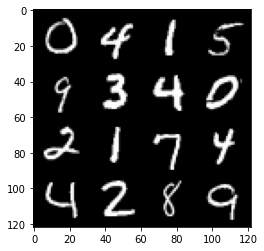

71: step 33300 / Gen_loss: 4.132954428990681 / Disc_loss: 0.2199980025986828


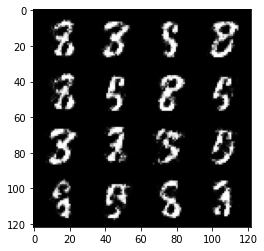

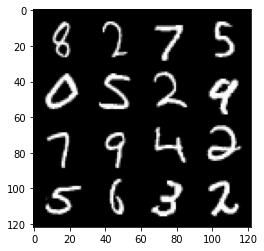

71: step 33600 / Gen_loss: 3.9970053188006105 / Disc_loss: 0.27166243058939765


  0%|          | 0/469 [00:00<?, ?it/s]

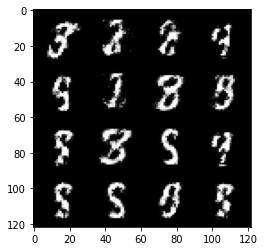

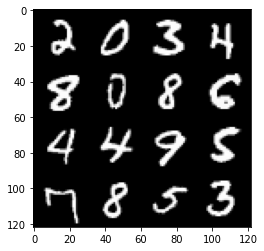

72: step 33900 / Gen_loss: 3.7474588457743323 / Disc_loss: 0.27683256126940203


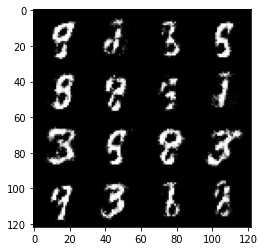

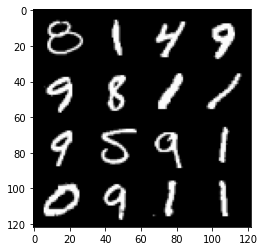

72: step 34200 / Gen_loss: 3.843926677703859 / Disc_loss: 0.24356958794097092


  0%|          | 0/469 [00:00<?, ?it/s]

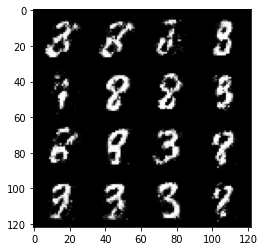

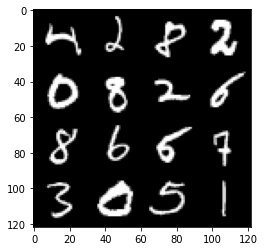

73: step 34500 / Gen_loss: 3.9355247116088856 / Disc_loss: 0.22846175817151876


  0%|          | 0/469 [00:00<?, ?it/s]

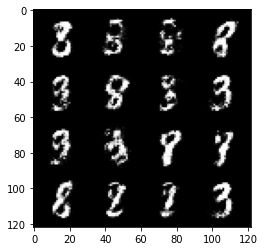

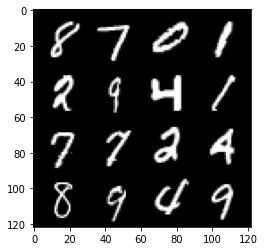

74: step 34800 / Gen_loss: 3.976823520660399 / Disc_loss: 0.24823074509700152


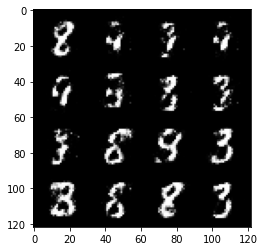

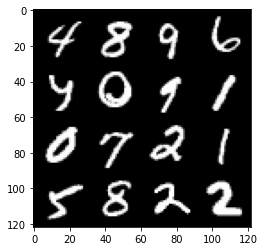

74: step 35100 / Gen_loss: 3.856859938303631 / Disc_loss: 0.2771160988509656


  0%|          | 0/469 [00:00<?, ?it/s]

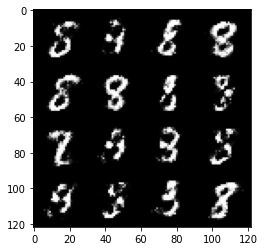

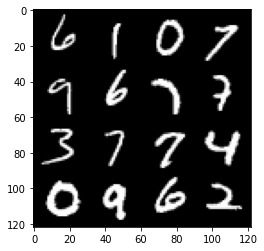

75: step 35400 / Gen_loss: 3.7286075997352586 / Disc_loss: 0.2621367681771519


  0%|          | 0/469 [00:00<?, ?it/s]

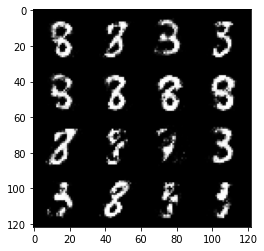

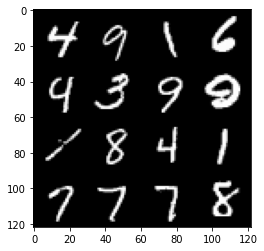

76: step 35700 / Gen_loss: 3.8633137750625606 / Disc_loss: 0.23205830059945595


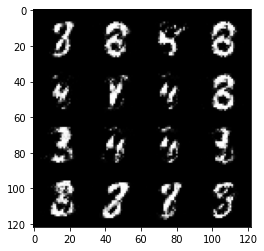

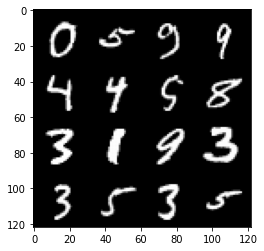

76: step 36000 / Gen_loss: 3.849510194460546 / Disc_loss: 0.2754566904157401


  0%|          | 0/469 [00:00<?, ?it/s]

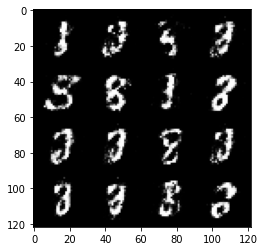

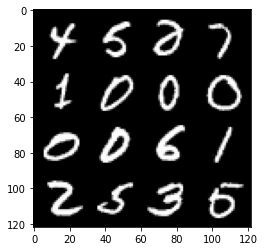

77: step 36300 / Gen_loss: 3.8443381690979 / Disc_loss: 0.2564663627247016


  0%|          | 0/469 [00:00<?, ?it/s]

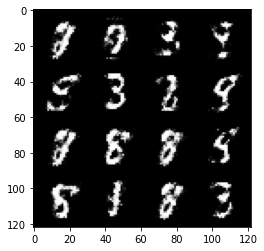

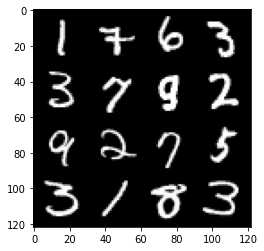

78: step 36600 / Gen_loss: 4.010535701115926 / Disc_loss: 0.25436677848299344


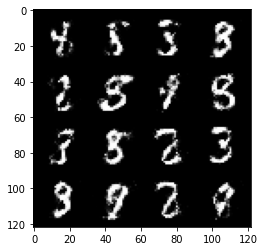

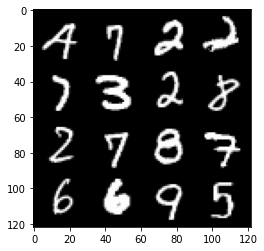

78: step 36900 / Gen_loss: 3.7298612372080475 / Disc_loss: 0.2886273648341497


  0%|          | 0/469 [00:00<?, ?it/s]

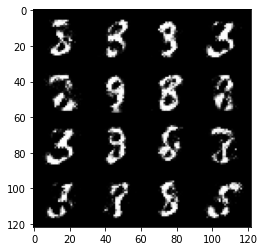

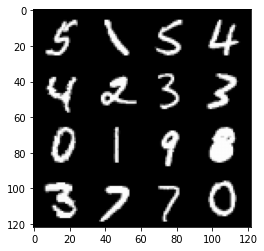

79: step 37200 / Gen_loss: 3.651676826477051 / Disc_loss: 0.270221811781327


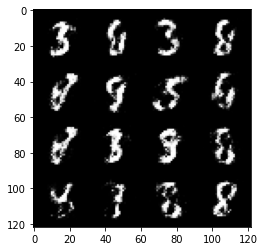

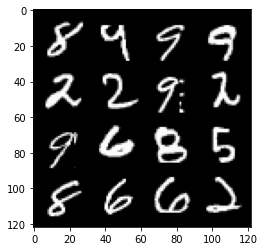

79: step 37500 / Gen_loss: 3.920234336853025 / Disc_loss: 0.2339815665533143


  0%|          | 0/469 [00:00<?, ?it/s]

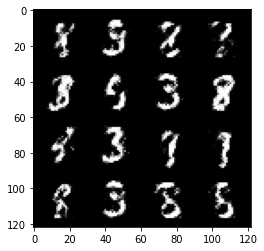

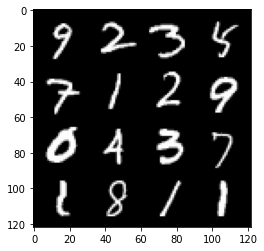

80: step 37800 / Gen_loss: 3.8025665116310132 / Disc_loss: 0.2890593263010183


  0%|          | 0/469 [00:00<?, ?it/s]

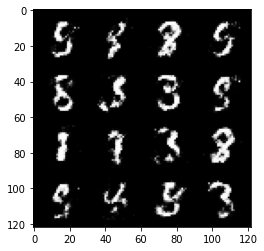

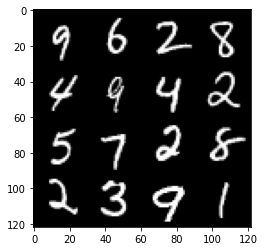

81: step 38100 / Gen_loss: 3.7596511713663734 / Disc_loss: 0.2855609909196696


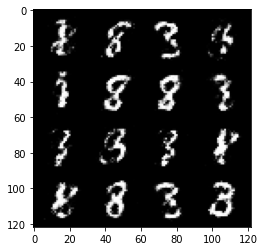

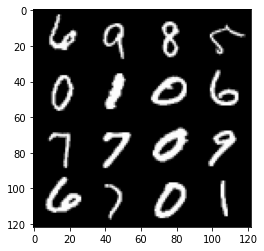

81: step 38400 / Gen_loss: 3.7853246418635074 / Disc_loss: 0.2787601461509862


  0%|          | 0/469 [00:00<?, ?it/s]

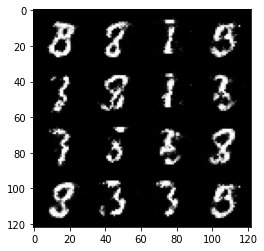

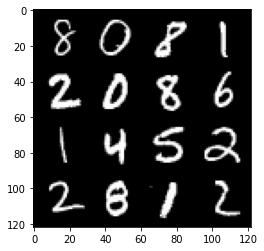

82: step 38700 / Gen_loss: 3.7074393979708393 / Disc_loss: 0.27989531184236194


  0%|          | 0/469 [00:00<?, ?it/s]

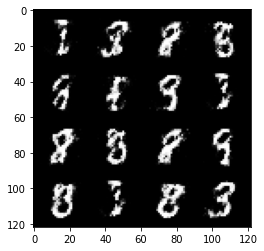

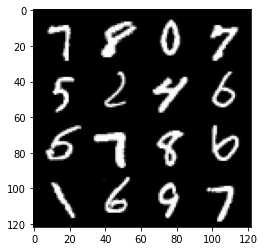

83: step 39000 / Gen_loss: 3.753157997131349 / Disc_loss: 0.26572675620516134


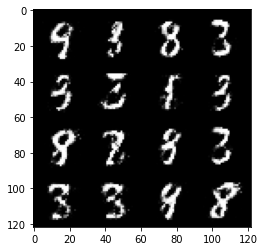

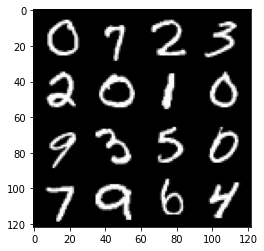

83: step 39300 / Gen_loss: 3.6072110374768562 / Disc_loss: 0.3014397193739811


  0%|          | 0/469 [00:00<?, ?it/s]

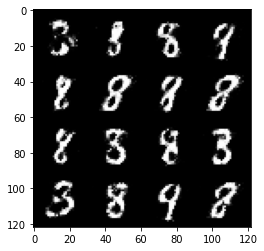

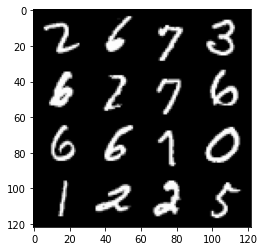

84: step 39600 / Gen_loss: 3.6476308512687687 / Disc_loss: 0.3035167516022919


  0%|          | 0/469 [00:00<?, ?it/s]

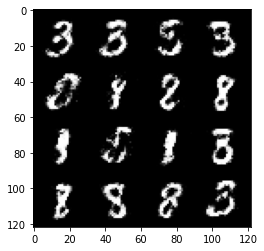

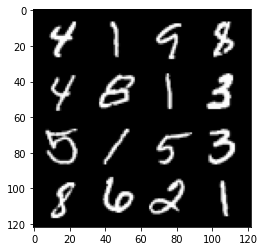

85: step 39900 / Gen_loss: 3.4949530967076607 / Disc_loss: 0.3174056837956111


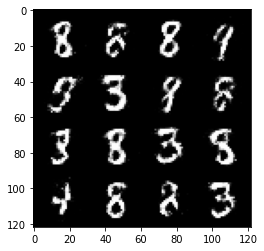

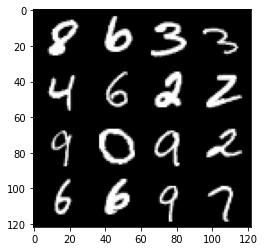

85: step 40200 / Gen_loss: 3.6047381424903877 / Disc_loss: 0.29283304115136466


  0%|          | 0/469 [00:00<?, ?it/s]

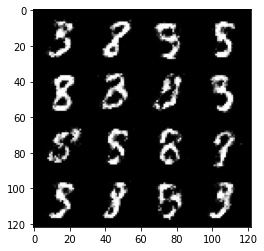

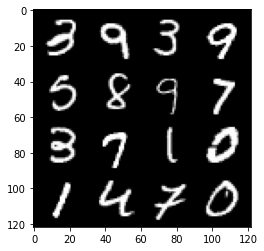

86: step 40500 / Gen_loss: 3.496173308690388 / Disc_loss: 0.33875399415691687


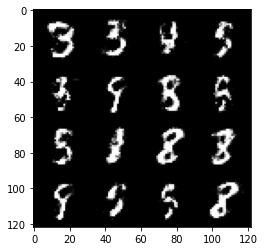

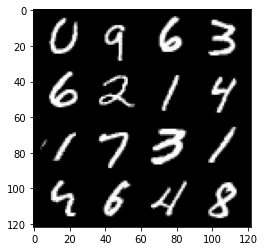

86: step 40800 / Gen_loss: 3.459411182403565 / Disc_loss: 0.328622367531061


  0%|          | 0/469 [00:00<?, ?it/s]

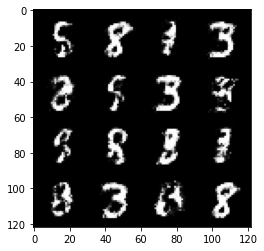

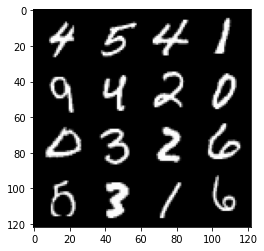

87: step 41100 / Gen_loss: 3.4484591174125647 / Disc_loss: 0.31794153024752936


  0%|          | 0/469 [00:00<?, ?it/s]

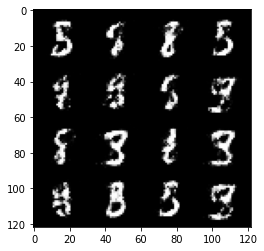

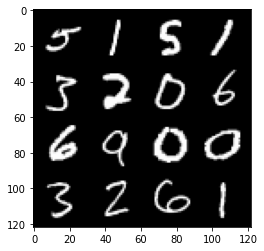

88: step 41400 / Gen_loss: 3.428597387472792 / Disc_loss: 0.3088278897106647


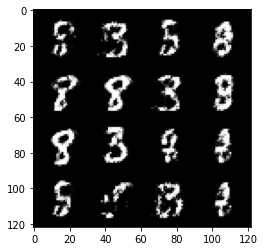

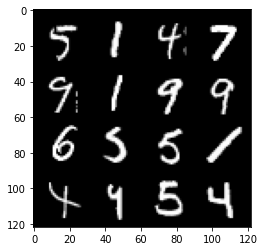

88: step 41700 / Gen_loss: 3.583934280872347 / Disc_loss: 0.31276532635092746


  0%|          | 0/469 [00:00<?, ?it/s]

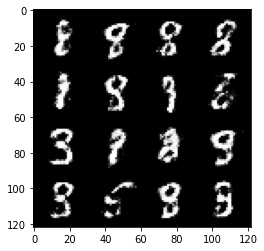

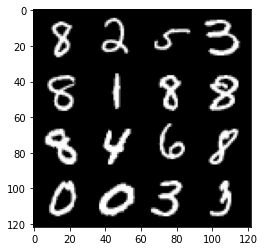

89: step 42000 / Gen_loss: 3.4671971694628367 / Disc_loss: 0.3187843584517638


  0%|          | 0/469 [00:00<?, ?it/s]

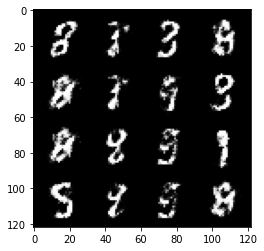

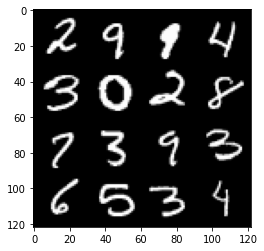

90: step 42300 / Gen_loss: 3.258033268451689 / Disc_loss: 0.3749407594402632


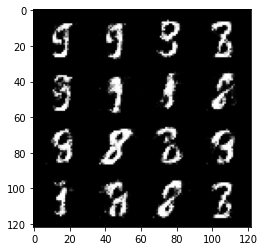

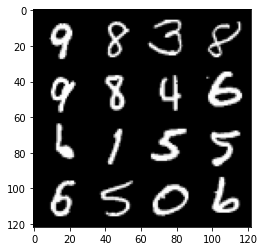

90: step 42600 / Gen_loss: 3.3061685395240774 / Disc_loss: 0.3353725200891496


  0%|          | 0/469 [00:00<?, ?it/s]

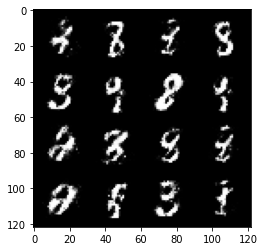

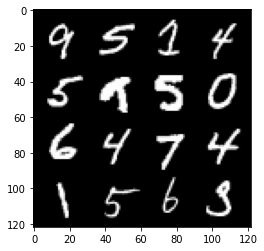

91: step 42900 / Gen_loss: 3.545211619536083 / Disc_loss: 0.3116281721492609


  0%|          | 0/469 [00:00<?, ?it/s]

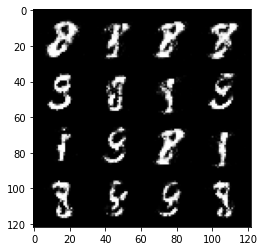

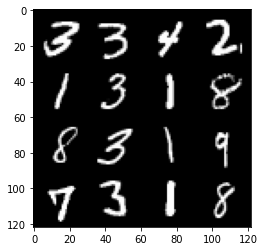

92: step 43200 / Gen_loss: 3.3849402221043885 / Disc_loss: 0.3334262097875275


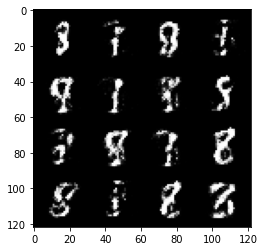

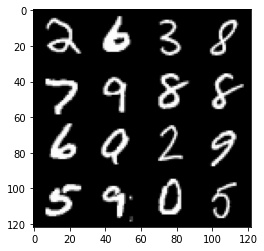

92: step 43500 / Gen_loss: 3.1505829819043494 / Disc_loss: 0.4084124068915842


  0%|          | 0/469 [00:00<?, ?it/s]

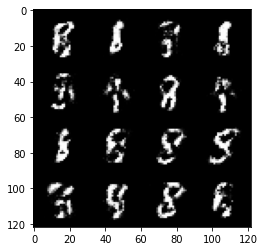

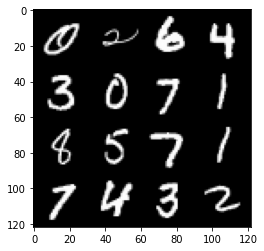

93: step 43800 / Gen_loss: 3.176195345719655 / Disc_loss: 0.38235664968689315


  0%|          | 0/469 [00:00<?, ?it/s]

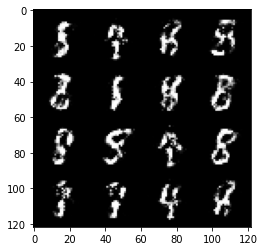

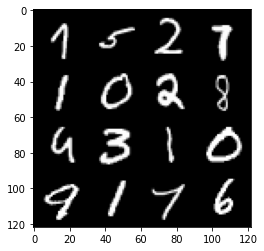

94: step 44100 / Gen_loss: 3.294382067521415 / Disc_loss: 0.322879063040018


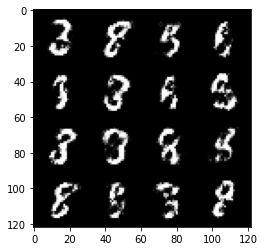

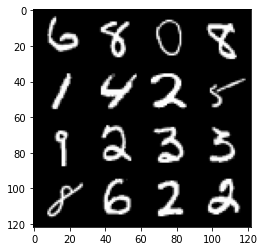

94: step 44400 / Gen_loss: 3.443482450644176 / Disc_loss: 0.3238455947240196


  0%|          | 0/469 [00:00<?, ?it/s]

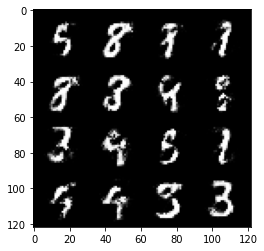

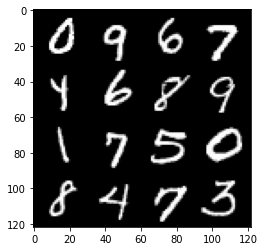

95: step 44700 / Gen_loss: 3.2224359639485667 / Disc_loss: 0.3484975680212179


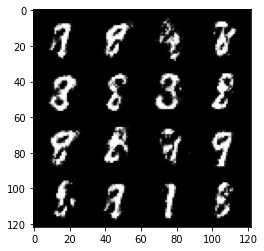

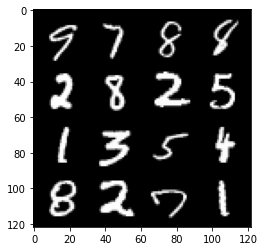

95: step 45000 / Gen_loss: 3.2025128833452867 / Disc_loss: 0.35152130857110037


  0%|          | 0/469 [00:00<?, ?it/s]

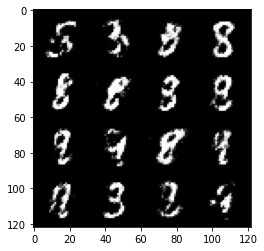

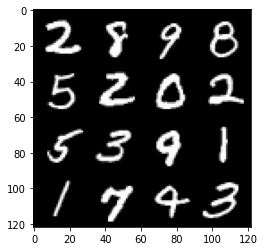

96: step 45300 / Gen_loss: 3.2960138130187975 / Disc_loss: 0.34150326167543743


  0%|          | 0/469 [00:00<?, ?it/s]

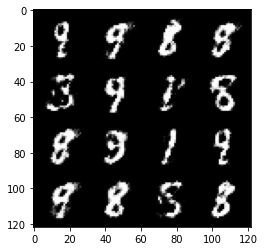

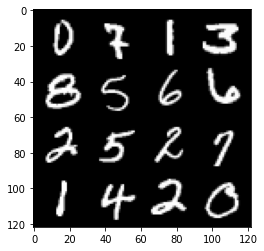

97: step 45600 / Gen_loss: 3.2068409077326434 / Disc_loss: 0.3788422829906144


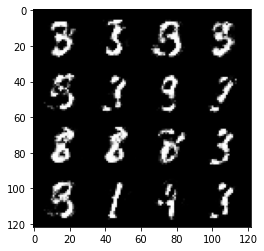

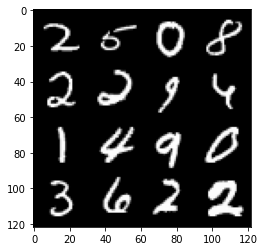

97: step 45900 / Gen_loss: 3.1611755291620884 / Disc_loss: 0.3630082479119304


  0%|          | 0/469 [00:00<?, ?it/s]

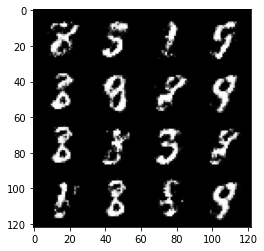

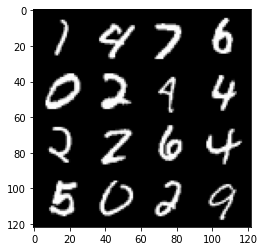

98: step 46200 / Gen_loss: 3.080367877483367 / Disc_loss: 0.36311590542395883


  0%|          | 0/469 [00:00<?, ?it/s]

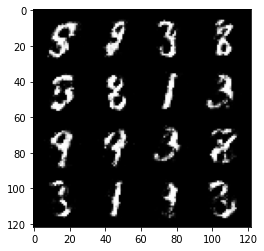

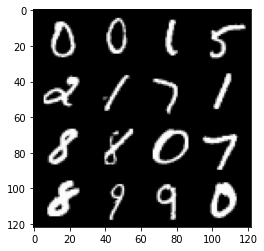

99: step 46500 / Gen_loss: 3.051122294267018 / Disc_loss: 0.3986460495988529


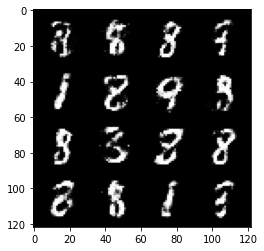

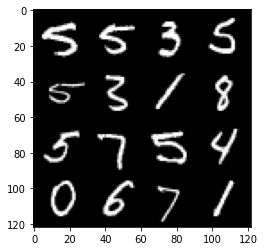

99: step 46800 / Gen_loss: 3.1069204529126466 / Disc_loss: 0.3856925987700618


  0%|          | 0/469 [00:00<?, ?it/s]

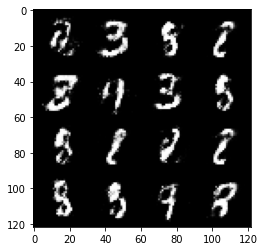

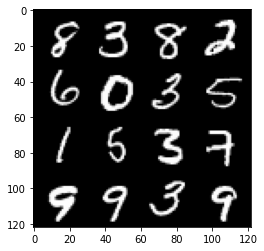

100: step 47100 / Gen_loss: 3.046406686306001 / Disc_loss: 0.41218679616848636


  0%|          | 0/469 [00:00<?, ?it/s]

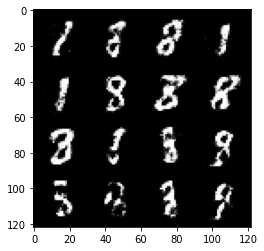

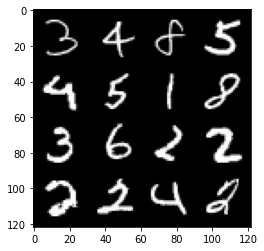

101: step 47400 / Gen_loss: 2.932288928826652 / Disc_loss: 0.434596339315176


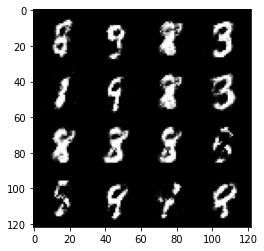

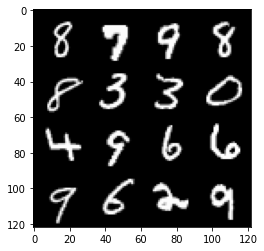

101: step 47700 / Gen_loss: 2.8721356614430738 / Disc_loss: 0.4362508908907567


  0%|          | 0/469 [00:00<?, ?it/s]

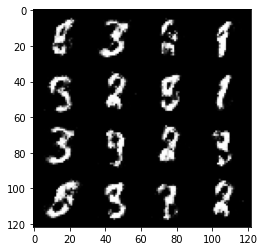

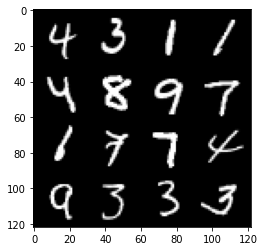

102: step 48000 / Gen_loss: 2.8002920611699427 / Disc_loss: 0.4770440139373144


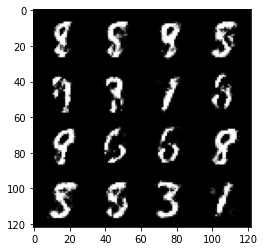

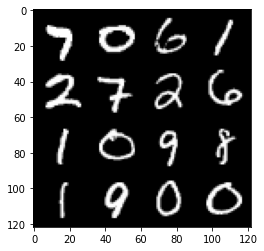

102: step 48300 / Gen_loss: 2.853008712132771 / Disc_loss: 0.4342537975311278


  0%|          | 0/469 [00:00<?, ?it/s]

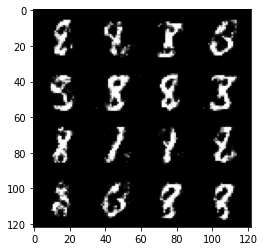

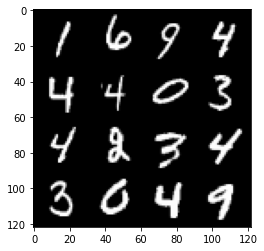

103: step 48600 / Gen_loss: 2.943147780100505 / Disc_loss: 0.43004918302098905


  0%|          | 0/469 [00:00<?, ?it/s]

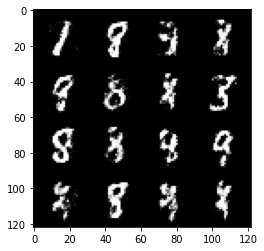

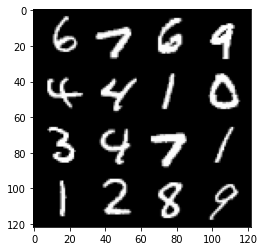

104: step 48900 / Gen_loss: 2.9415742270151775 / Disc_loss: 0.4690517161786558


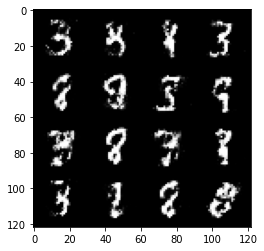

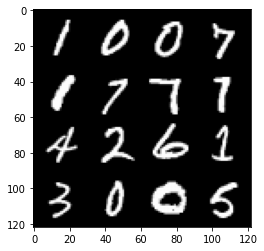

104: step 49200 / Gen_loss: 2.900100785891215 / Disc_loss: 0.4366335136691726


  0%|          | 0/469 [00:00<?, ?it/s]

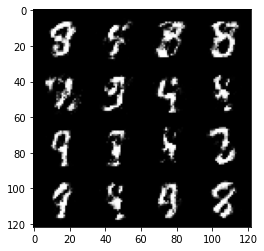

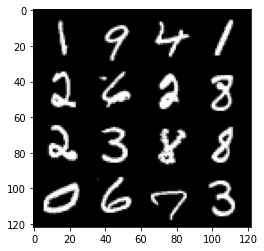

105: step 49500 / Gen_loss: 2.9350213495890296 / Disc_loss: 0.4265988061825435


  0%|          | 0/469 [00:00<?, ?it/s]

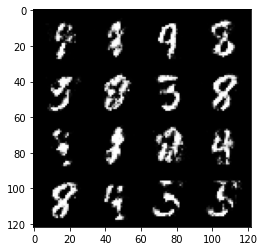

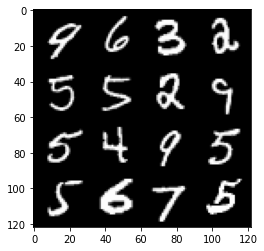

106: step 49800 / Gen_loss: 2.7836614759763094 / Disc_loss: 0.45255629425247496


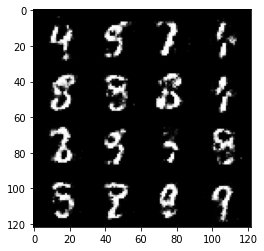

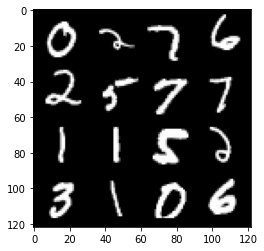

106: step 50100 / Gen_loss: 2.8389665985107433 / Disc_loss: 0.40627028435468654


  0%|          | 0/469 [00:00<?, ?it/s]

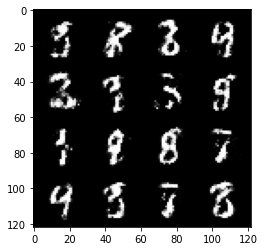

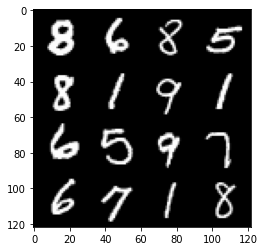

107: step 50400 / Gen_loss: 2.8891097696622214 / Disc_loss: 0.3990685549378396


  0%|          | 0/469 [00:00<?, ?it/s]

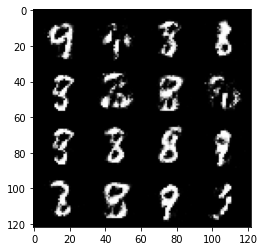

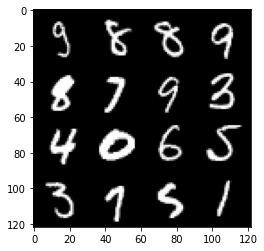

108: step 50700 / Gen_loss: 2.912543539206187 / Disc_loss: 0.3852438971400257


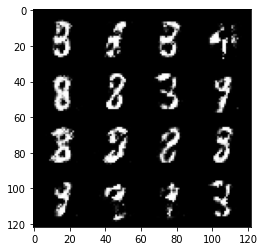

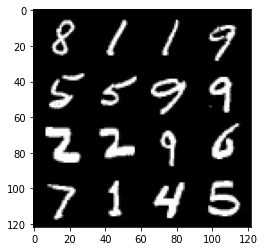

108: step 51000 / Gen_loss: 2.982071813742319 / Disc_loss: 0.3790176122387249


  0%|          | 0/469 [00:00<?, ?it/s]

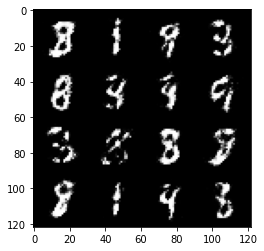

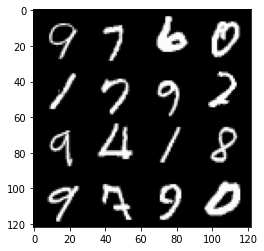

109: step 51300 / Gen_loss: 2.890961000919341 / Disc_loss: 0.40836776817838355


  0%|          | 0/469 [00:00<?, ?it/s]

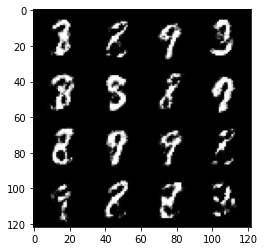

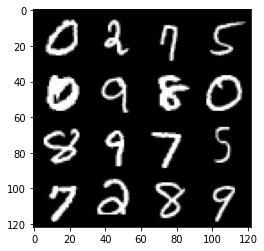

110: step 51600 / Gen_loss: 2.822102934519448 / Disc_loss: 0.450464371194442


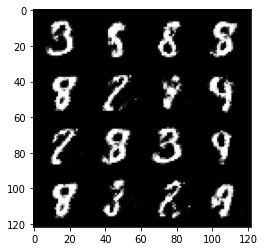

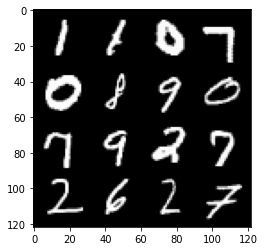

110: step 51900 / Gen_loss: 2.772981858253478 / Disc_loss: 0.44976891010999676


  0%|          | 0/469 [00:00<?, ?it/s]

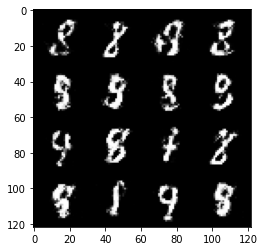

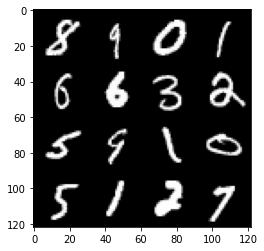

111: step 52200 / Gen_loss: 2.8217328564325963 / Disc_loss: 0.4394294121861456


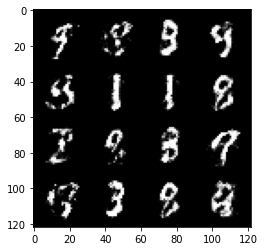

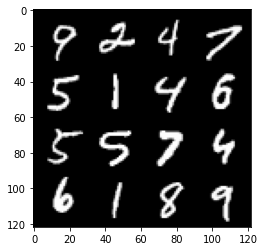

111: step 52500 / Gen_loss: 2.6971710332234675 / Disc_loss: 0.456013701160749


  0%|          | 0/469 [00:00<?, ?it/s]

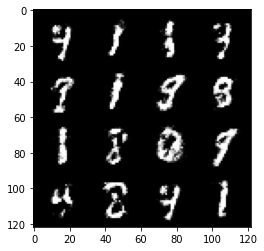

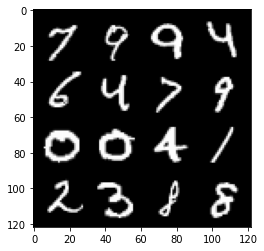

112: step 52800 / Gen_loss: 2.71059954126676 / Disc_loss: 0.48120364258686715


  0%|          | 0/469 [00:00<?, ?it/s]

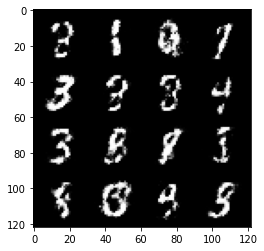

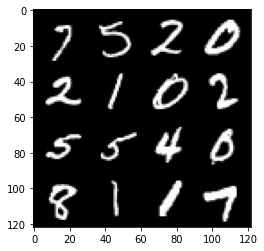

113: step 53100 / Gen_loss: 2.59810101310412 / Disc_loss: 0.5104247172673545


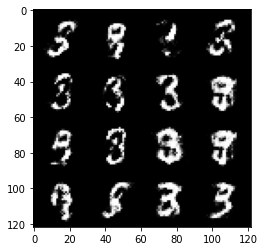

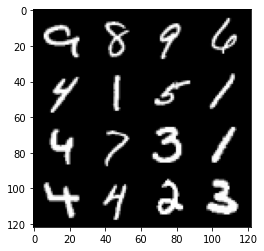

113: step 53400 / Gen_loss: 2.6494527014096576 / Disc_loss: 0.4804294690489769


  0%|          | 0/469 [00:00<?, ?it/s]

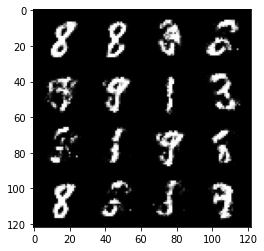

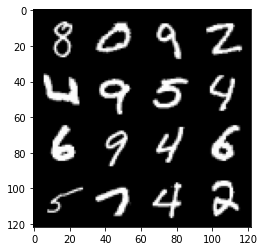

114: step 53700 / Gen_loss: 2.7298339343071 / Disc_loss: 0.4729671599467595


  0%|          | 0/469 [00:00<?, ?it/s]

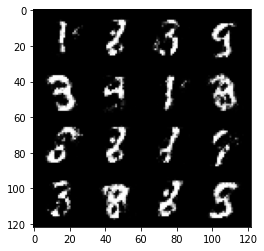

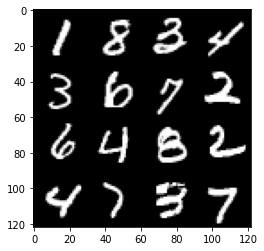

115: step 54000 / Gen_loss: 2.782909030914304 / Disc_loss: 0.46501144419113793


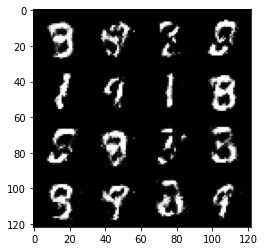

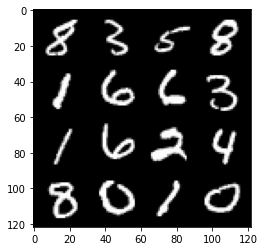

115: step 54300 / Gen_loss: 2.7701819992065446 / Disc_loss: 0.48144694050153103


  0%|          | 0/469 [00:00<?, ?it/s]

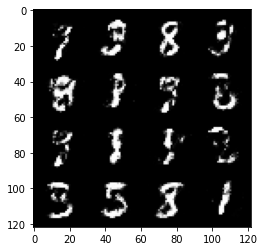

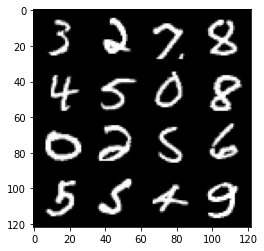

116: step 54600 / Gen_loss: 2.6707266680399586 / Disc_loss: 0.47912460704644544


  0%|          | 0/469 [00:00<?, ?it/s]

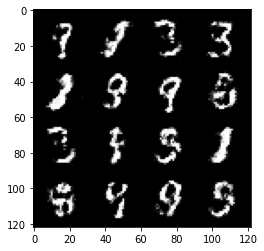

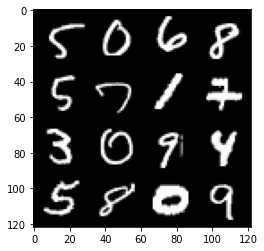

117: step 54900 / Gen_loss: 2.5466673513253535 / Disc_loss: 0.5083675286173817


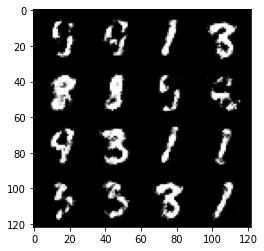

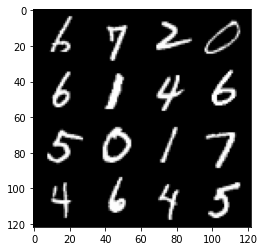

117: step 55200 / Gen_loss: 2.590414903163909 / Disc_loss: 0.5013185292482374


  0%|          | 0/469 [00:00<?, ?it/s]

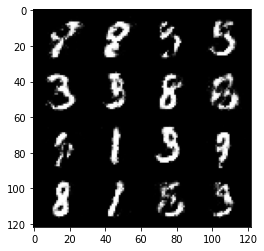

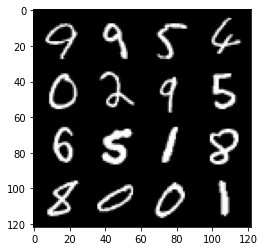

118: step 55500 / Gen_loss: 2.5934561868508674 / Disc_loss: 0.5186409899592398


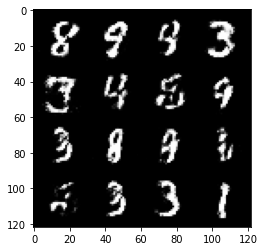

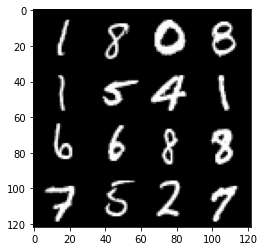

118: step 55800 / Gen_loss: 2.4281123423576365 / Disc_loss: 0.5721002492308619


  0%|          | 0/469 [00:00<?, ?it/s]

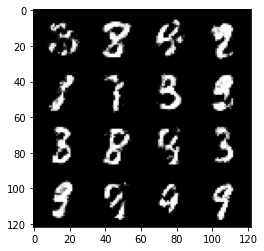

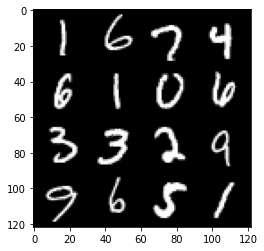

119: step 56100 / Gen_loss: 2.4638695549964913 / Disc_loss: 0.5154133029778802


  0%|          | 0/469 [00:00<?, ?it/s]

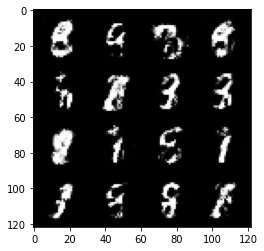

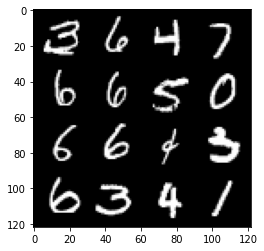

120: step 56400 / Gen_loss: 2.4983082640171044 / Disc_loss: 0.5261576867103576


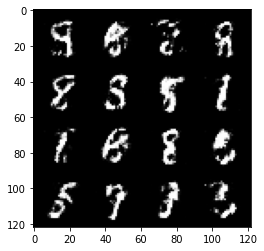

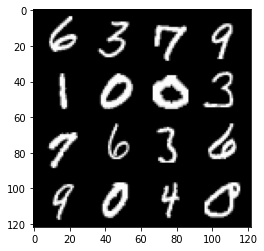

120: step 56700 / Gen_loss: 2.4202637195587164 / Disc_loss: 0.5688474080959957


  0%|          | 0/469 [00:00<?, ?it/s]

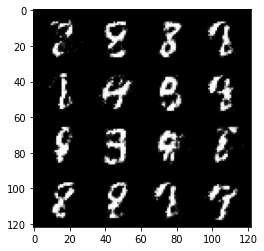

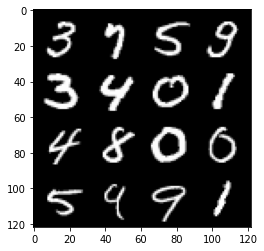

121: step 57000 / Gen_loss: 2.4274322275320674 / Disc_loss: 0.5639900312821072


  0%|          | 0/469 [00:00<?, ?it/s]

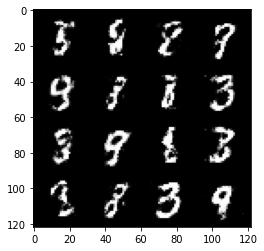

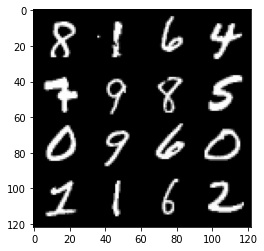

122: step 57300 / Gen_loss: 2.397530843019485 / Disc_loss: 0.5771055421233172


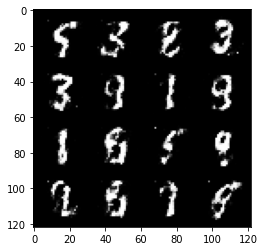

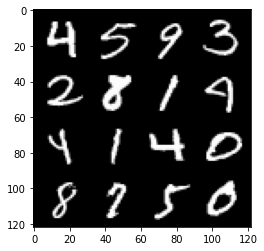

122: step 57600 / Gen_loss: 2.3669476926326776 / Disc_loss: 0.5494336056709292


  0%|          | 0/469 [00:00<?, ?it/s]

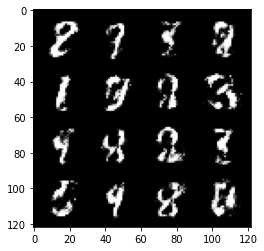

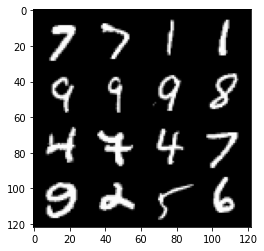

123: step 57900 / Gen_loss: 2.4009982709089903 / Disc_loss: 0.5527901095151904


  0%|          | 0/469 [00:00<?, ?it/s]

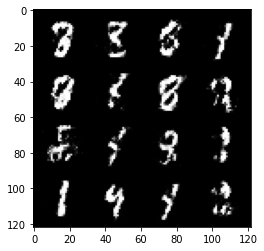

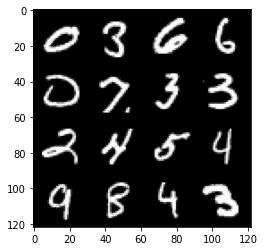

124: step 58200 / Gen_loss: 2.4545156145095826 / Disc_loss: 0.5580699491500858


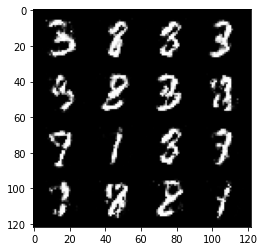

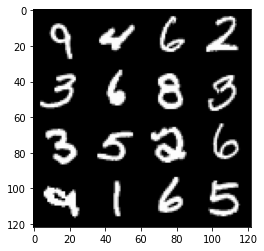

124: step 58500 / Gen_loss: 2.448838028907775 / Disc_loss: 0.557662519713243


  0%|          | 0/469 [00:00<?, ?it/s]

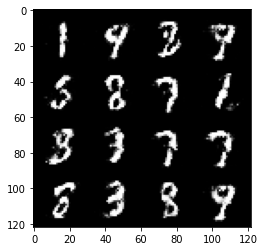

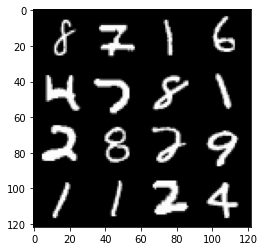

125: step 58800 / Gen_loss: 2.3958672686417892 / Disc_loss: 0.5590880943338074


  0%|          | 0/469 [00:00<?, ?it/s]

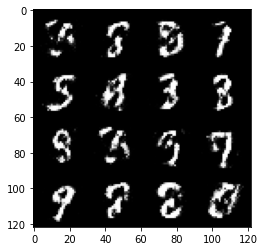

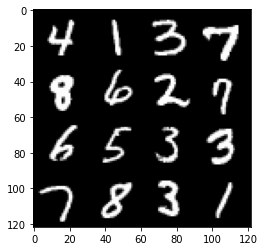

126: step 59100 / Gen_loss: 2.3356288977464033 / Disc_loss: 0.5530827769637106


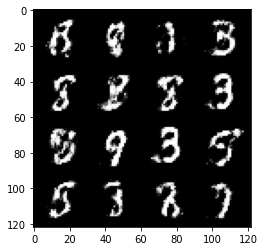

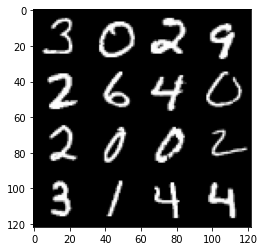

126: step 59400 / Gen_loss: 2.340604855219522 / Disc_loss: 0.5469413950045903


  0%|          | 0/469 [00:00<?, ?it/s]

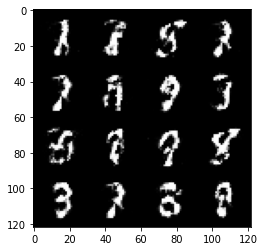

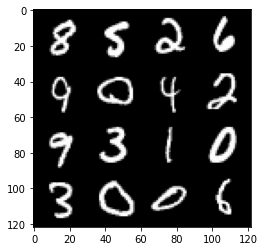

127: step 59700 / Gen_loss: 2.3468776627381636 / Disc_loss: 0.5449183921019237


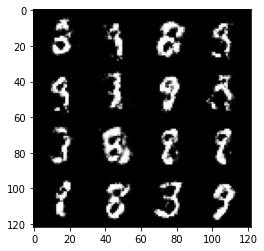

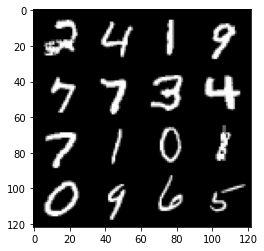

127: step 60000 / Gen_loss: 2.433027657667795 / Disc_loss: 0.5078607932726542


  0%|          | 0/469 [00:00<?, ?it/s]

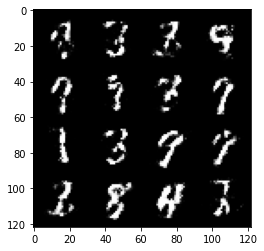

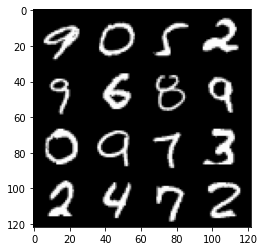

128: step 60300 / Gen_loss: 2.485778374671936 / Disc_loss: 0.5165404810508096


  0%|          | 0/469 [00:00<?, ?it/s]

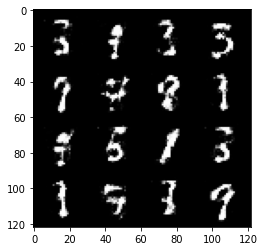

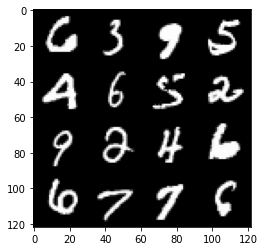

129: step 60600 / Gen_loss: 2.388428799708683 / Disc_loss: 0.5325038455923398


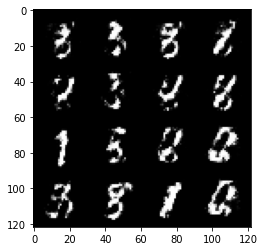

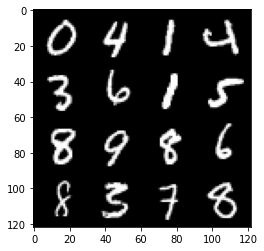

129: step 60900 / Gen_loss: 2.421562014818191 / Disc_loss: 0.5316851596037547


  0%|          | 0/469 [00:00<?, ?it/s]

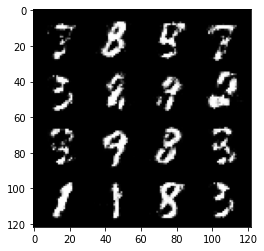

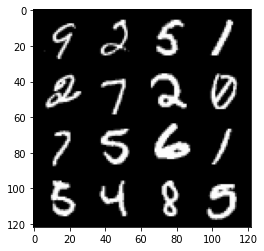

130: step 61200 / Gen_loss: 2.394781839847565 / Disc_loss: 0.5183007844289145


  0%|          | 0/469 [00:00<?, ?it/s]

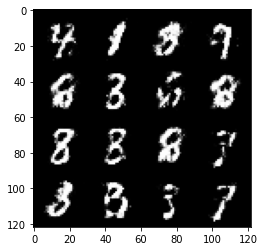

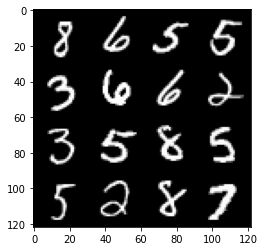

131: step 61500 / Gen_loss: 2.3618653770287836 / Disc_loss: 0.5526328690846765


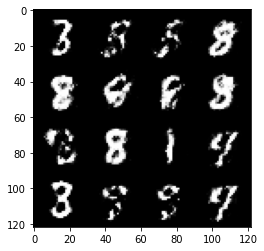

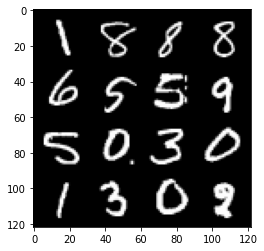

131: step 61800 / Gen_loss: 2.3073139369487756 / Disc_loss: 0.5573831100265185


  0%|          | 0/469 [00:00<?, ?it/s]

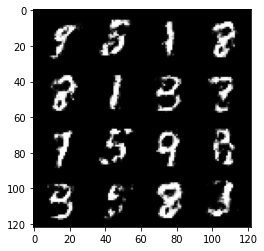

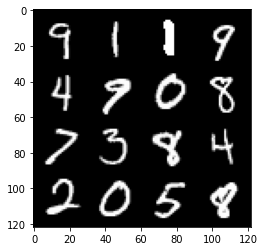

132: step 62100 / Gen_loss: 2.098802743752796 / Disc_loss: 0.67902352253596


  0%|          | 0/469 [00:00<?, ?it/s]

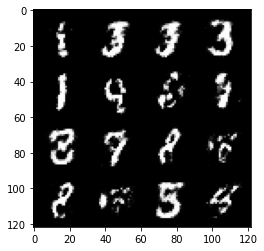

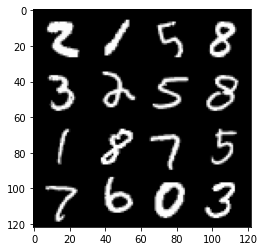

133: step 62400 / Gen_loss: 2.114284006357191 / Disc_loss: 0.6424489749471348


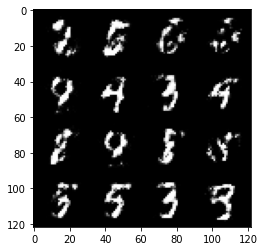

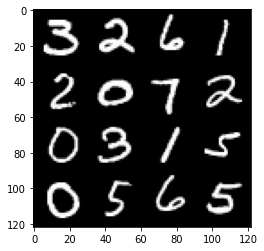

133: step 62700 / Gen_loss: 2.1898499266306533 / Disc_loss: 0.6133167556921635


  0%|          | 0/469 [00:00<?, ?it/s]

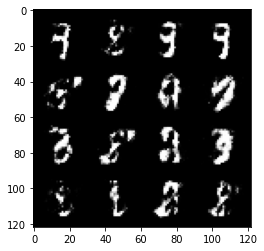

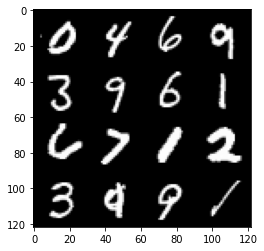

134: step 63000 / Gen_loss: 2.2742166197299944 / Disc_loss: 0.5987664399544399


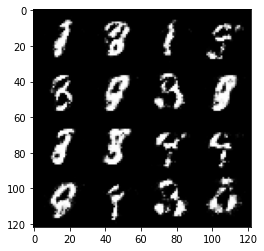

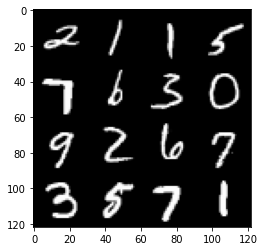

134: step 63300 / Gen_loss: 2.309557860692343 / Disc_loss: 0.5778539172808329


  0%|          | 0/469 [00:00<?, ?it/s]

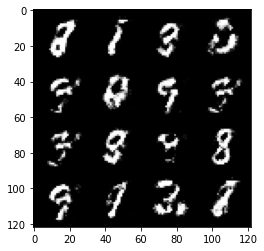

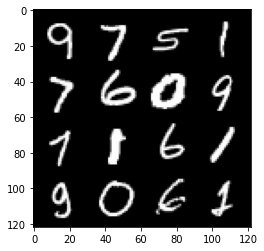

135: step 63600 / Gen_loss: 2.274842123190563 / Disc_loss: 0.5971525690952935


  0%|          | 0/469 [00:00<?, ?it/s]

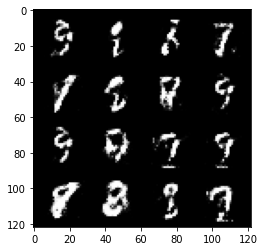

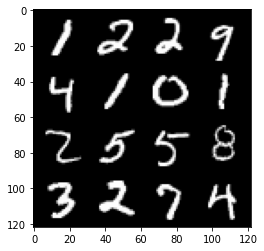

136: step 63900 / Gen_loss: 2.2504741577307383 / Disc_loss: 0.5826168640454609


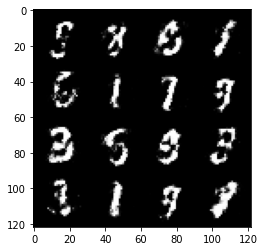

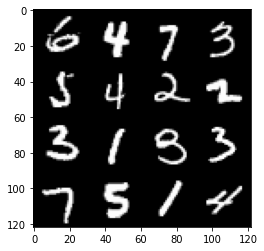

136: step 64200 / Gen_loss: 2.184698758920033 / Disc_loss: 0.5832936560114228


  0%|          | 0/469 [00:00<?, ?it/s]

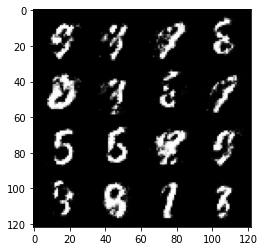

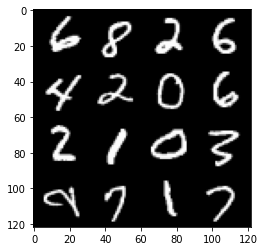

137: step 64500 / Gen_loss: 2.1732835443814595 / Disc_loss: 0.6368652698397631


  0%|          | 0/469 [00:00<?, ?it/s]

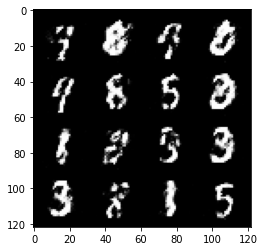

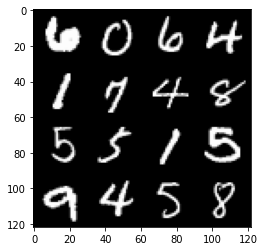

138: step 64800 / Gen_loss: 2.174652245442073 / Disc_loss: 0.6164658671617509


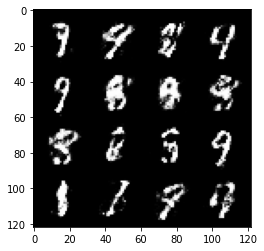

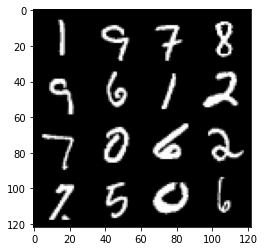

138: step 65100 / Gen_loss: 2.060867014328638 / Disc_loss: 0.681845668752988


  0%|          | 0/469 [00:00<?, ?it/s]

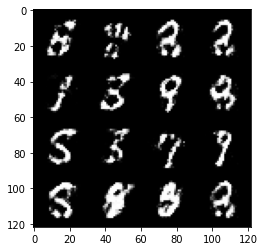

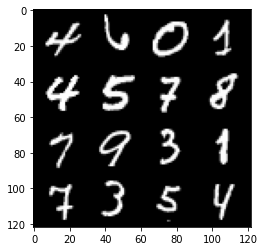

139: step 65400 / Gen_loss: 1.9458471751213078 / Disc_loss: 0.7201394639412556


  0%|          | 0/469 [00:00<?, ?it/s]

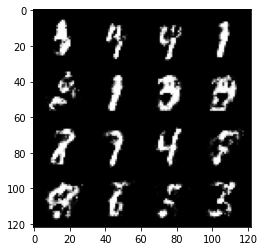

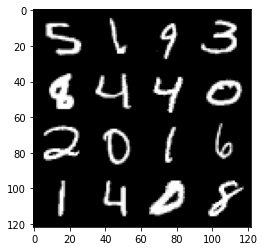

140: step 65700 / Gen_loss: 2.0041262467702223 / Disc_loss: 0.6538964990774798


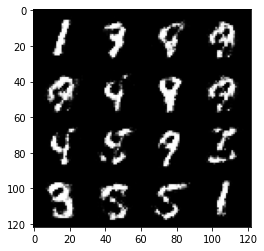

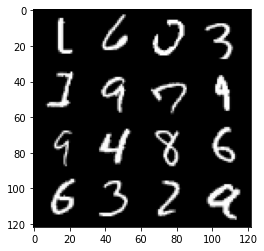

140: step 66000 / Gen_loss: 1.959754685560863 / Disc_loss: 0.7082090334097544


  0%|          | 0/469 [00:00<?, ?it/s]

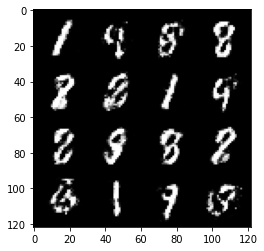

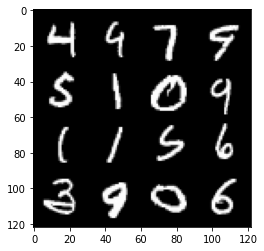

141: step 66300 / Gen_loss: 1.9929140965143834 / Disc_loss: 0.6774768440922107


  0%|          | 0/469 [00:00<?, ?it/s]

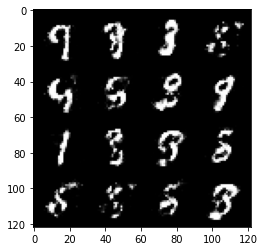

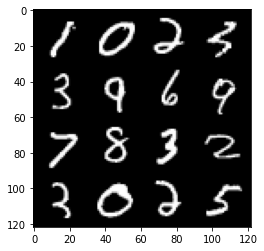

142: step 66600 / Gen_loss: 1.9840193974971774 / Disc_loss: 0.6821731625000635


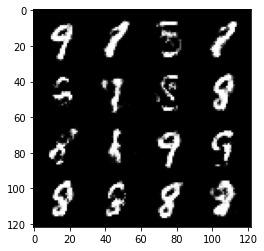

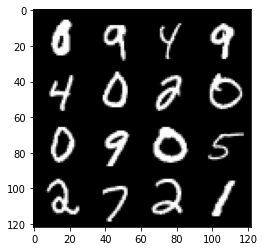

142: step 66900 / Gen_loss: 1.981158233483631 / Disc_loss: 0.6517757584651312


  0%|          | 0/469 [00:00<?, ?it/s]

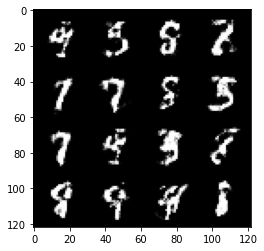

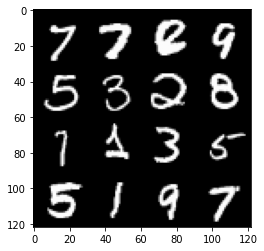

143: step 67200 / Gen_loss: 2.03309801697731 / Disc_loss: 0.6288506270448363


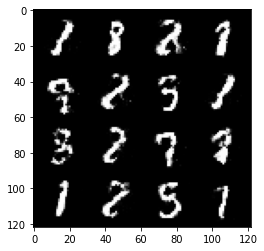

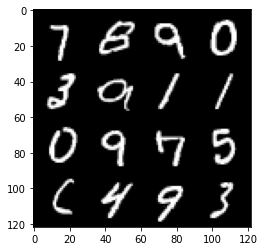

143: step 67500 / Gen_loss: 1.9860953648885091 / Disc_loss: 0.645502321124077


  0%|          | 0/469 [00:00<?, ?it/s]

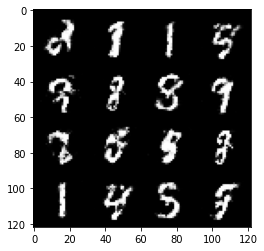

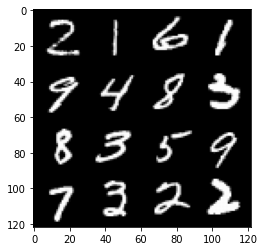

144: step 67800 / Gen_loss: 1.987438075145084 / Disc_loss: 0.6792631180087726


  0%|          | 0/469 [00:00<?, ?it/s]

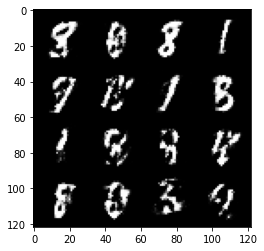

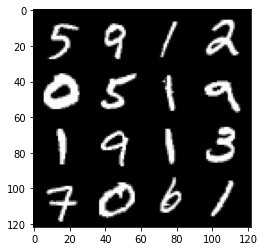

145: step 68100 / Gen_loss: 1.8862650124231968 / Disc_loss: 0.7116710360844928


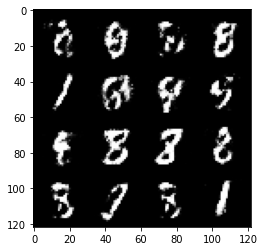

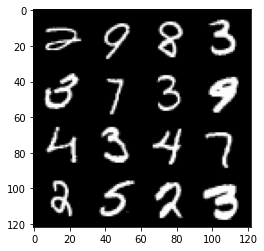

145: step 68400 / Gen_loss: 1.8870099286238353 / Disc_loss: 0.7049379082520792


  0%|          | 0/469 [00:00<?, ?it/s]

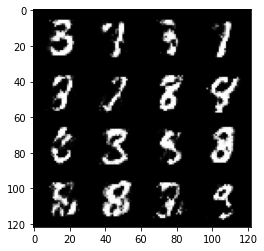

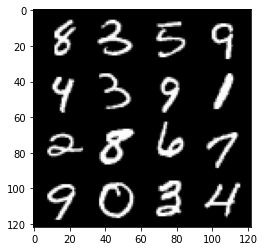

146: step 68700 / Gen_loss: 1.9451935100555424 / Disc_loss: 0.6797106481591858


  0%|          | 0/469 [00:00<?, ?it/s]

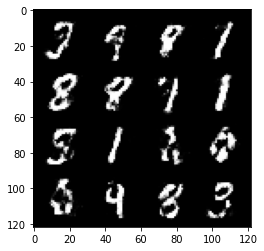

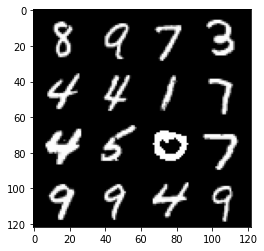

147: step 69000 / Gen_loss: 1.854161250591278 / Disc_loss: 0.7267957218488056


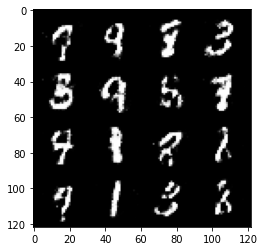

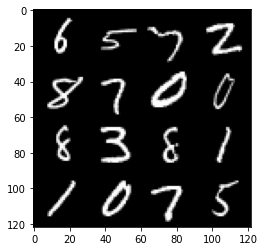

147: step 69300 / Gen_loss: 1.8697866892814627 / Disc_loss: 0.7055525451898574


  0%|          | 0/469 [00:00<?, ?it/s]

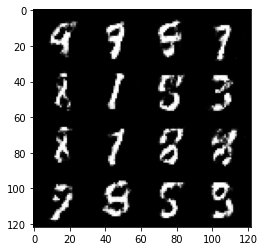

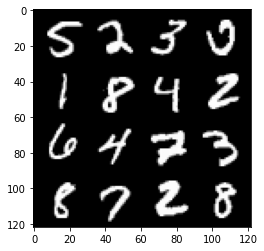

148: step 69600 / Gen_loss: 1.9314543974399565 / Disc_loss: 0.6848468710978822


  0%|          | 0/469 [00:00<?, ?it/s]

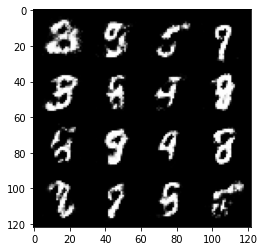

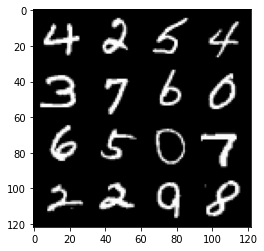

149: step 69900 / Gen_loss: 1.7473798235257472 / Disc_loss: 0.7901781914631523


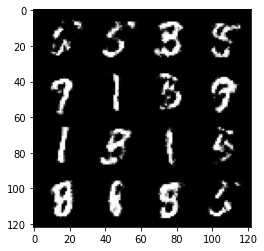

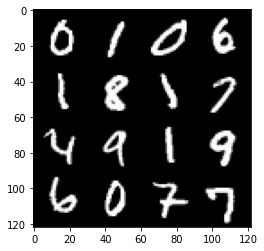

149: step 70200 / Gen_loss: 1.750775546630225 / Disc_loss: 0.7676727485656731


  0%|          | 0/469 [00:00<?, ?it/s]

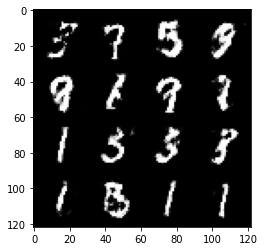

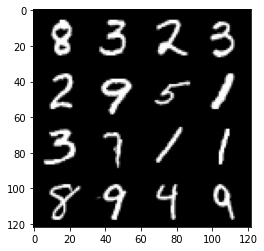

150: step 70500 / Gen_loss: 1.7920325164000186 / Disc_loss: 0.7349833232164376


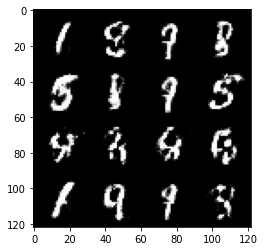

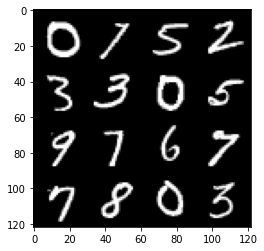

150: step 70800 / Gen_loss: 1.6595135315259302 / Disc_loss: 0.7981880970795947


  0%|          | 0/469 [00:00<?, ?it/s]

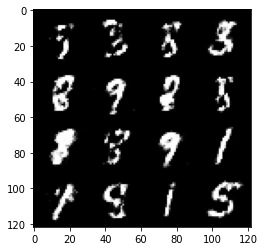

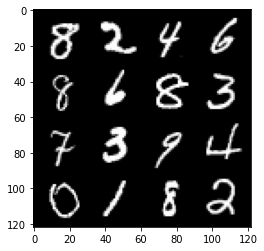

151: step 71100 / Gen_loss: 1.759239175717036 / Disc_loss: 0.7309776290257773


  0%|          | 0/469 [00:00<?, ?it/s]

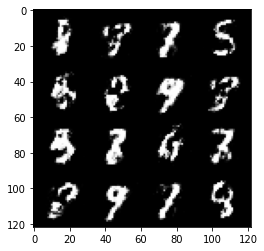

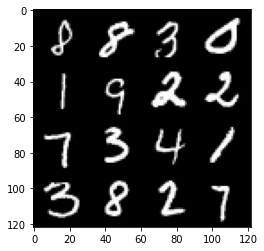

152: step 71400 / Gen_loss: 1.8399616722265881 / Disc_loss: 0.7143426585197449


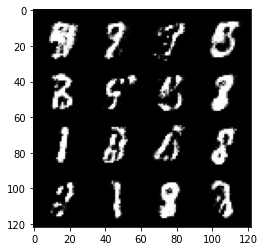

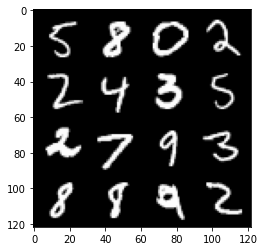

152: step 71700 / Gen_loss: 1.7375250494480132 / Disc_loss: 0.7643765471378963


  0%|          | 0/469 [00:00<?, ?it/s]

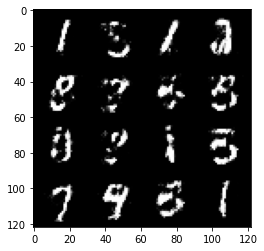

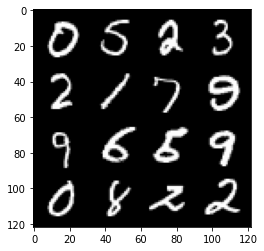

153: step 72000 / Gen_loss: 1.7255427996317556 / Disc_loss: 0.7589393027623489


  0%|          | 0/469 [00:00<?, ?it/s]

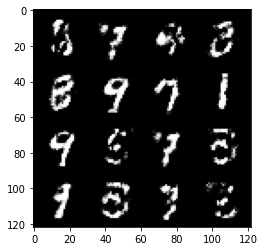

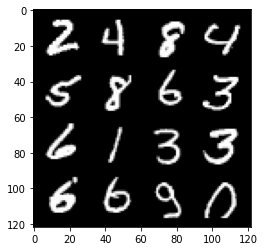

154: step 72300 / Gen_loss: 1.7437594159444172 / Disc_loss: 0.7673704869548471


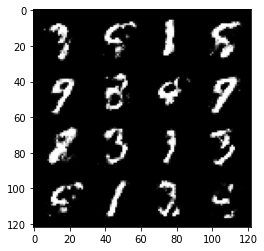

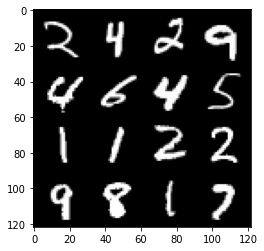

154: step 72600 / Gen_loss: 1.7502597117424008 / Disc_loss: 0.7575286102294921


  0%|          | 0/469 [00:00<?, ?it/s]

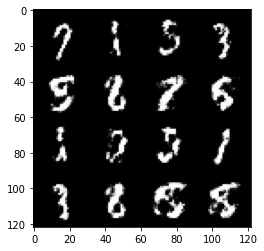

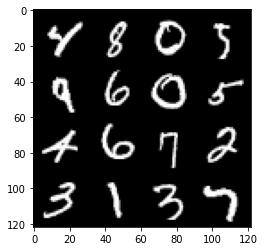

155: step 72900 / Gen_loss: 1.8352863685290022 / Disc_loss: 0.6999149781465522


  0%|          | 0/469 [00:00<?, ?it/s]

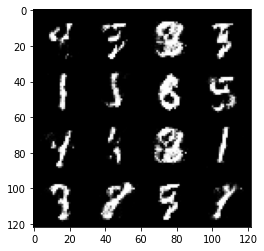

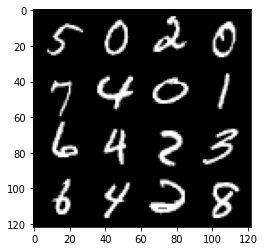

156: step 73200 / Gen_loss: 1.9131464934349058 / Disc_loss: 0.6625769841670984


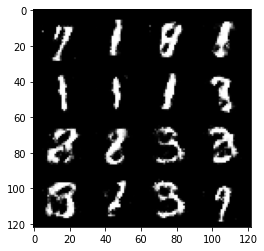

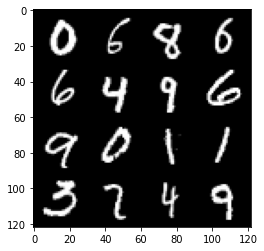

156: step 73500 / Gen_loss: 1.7993373318513244 / Disc_loss: 0.7355914717912674


  0%|          | 0/469 [00:00<?, ?it/s]

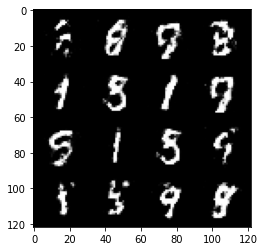

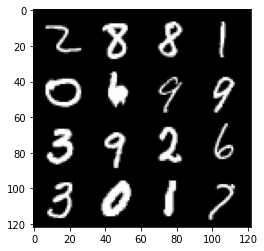

157: step 73800 / Gen_loss: 1.7580637562274923 / Disc_loss: 0.7461699146032332


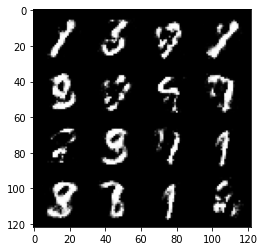

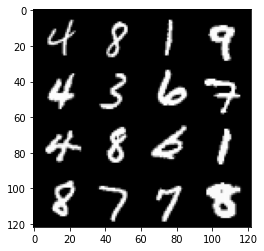

157: step 74100 / Gen_loss: 1.8446772138277698 / Disc_loss: 0.7286278742551803


  0%|          | 0/469 [00:00<?, ?it/s]

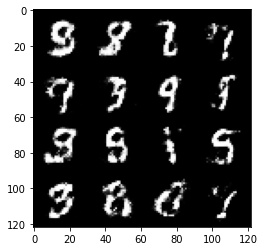

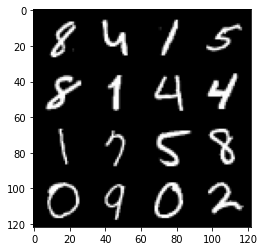

158: step 74400 / Gen_loss: 1.7482576978206632 / Disc_loss: 0.7629352867603301


  0%|          | 0/469 [00:00<?, ?it/s]

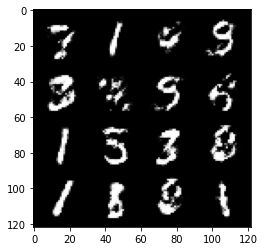

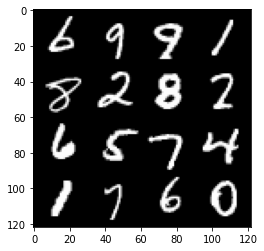

159: step 74700 / Gen_loss: 1.8382913096745788 / Disc_loss: 0.6972574218114218


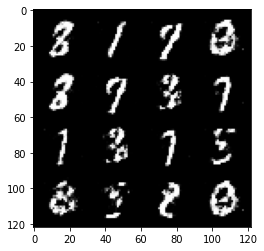

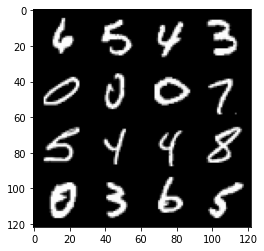

159: step 75000 / Gen_loss: 1.8001501059532168 / Disc_loss: 0.7153489540020622


  0%|          | 0/469 [00:00<?, ?it/s]

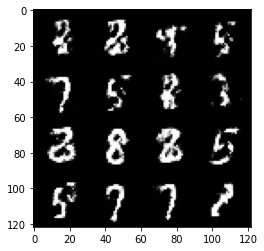

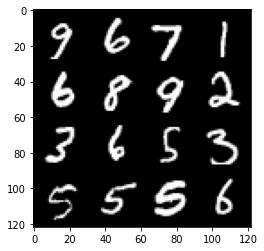

160: step 75300 / Gen_loss: 1.7998051075140629 / Disc_loss: 0.7310656209786732


  0%|          | 0/469 [00:00<?, ?it/s]

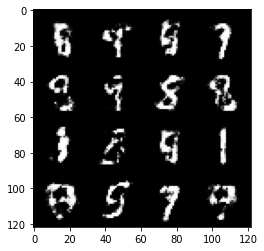

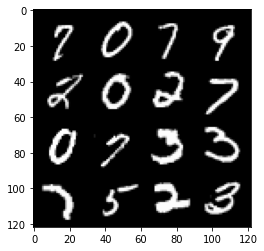

161: step 75600 / Gen_loss: 1.757189489205678 / Disc_loss: 0.7399822978178653


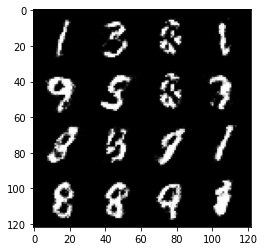

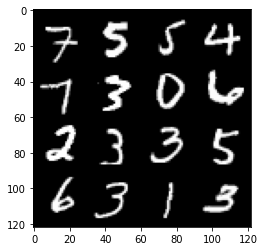

161: step 75900 / Gen_loss: 1.8266021335124971 / Disc_loss: 0.7109629734357199


  0%|          | 0/469 [00:00<?, ?it/s]

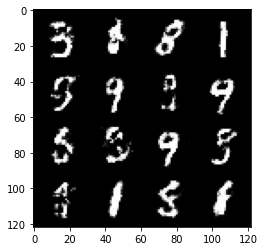

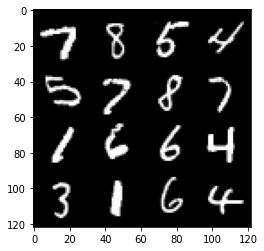

162: step 76200 / Gen_loss: 1.8357571677366906 / Disc_loss: 0.7050328399737673


  0%|          | 0/469 [00:00<?, ?it/s]

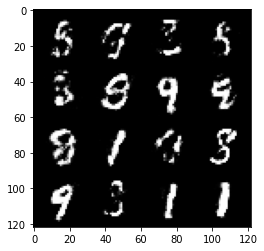

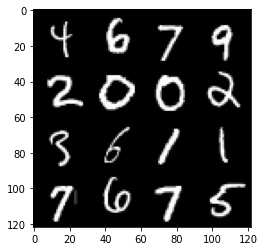

163: step 76500 / Gen_loss: 1.8217907782395688 / Disc_loss: 0.6923755230506264


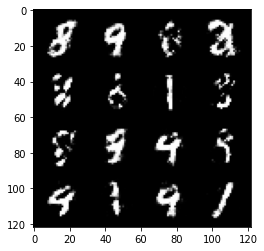

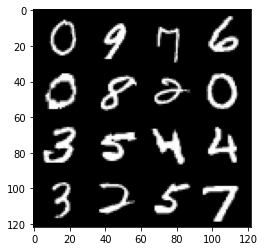

163: step 76800 / Gen_loss: 1.8428333946069106 / Disc_loss: 0.6666992870966594


  0%|          | 0/469 [00:00<?, ?it/s]

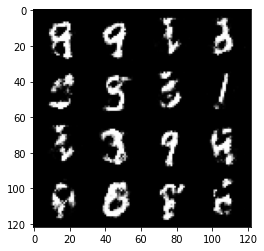

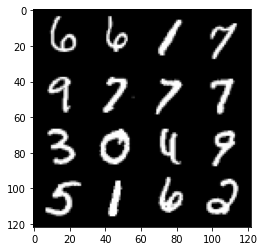

164: step 77100 / Gen_loss: 1.7638886984189341 / Disc_loss: 0.7459604044755304


  0%|          | 0/469 [00:00<?, ?it/s]

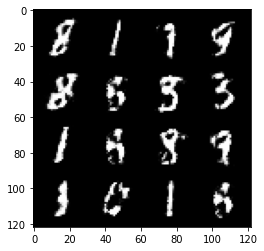

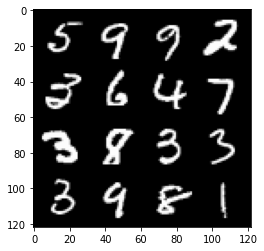

165: step 77400 / Gen_loss: 1.6787869207064285 / Disc_loss: 0.7851814037561418


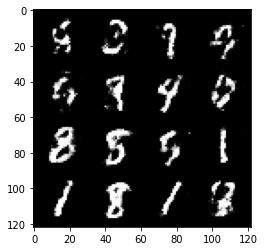

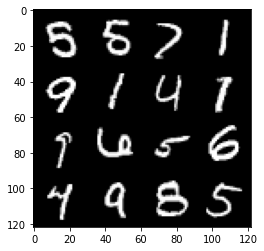

165: step 77700 / Gen_loss: 1.7746361772219355 / Disc_loss: 0.7399784461657205


  0%|          | 0/469 [00:00<?, ?it/s]

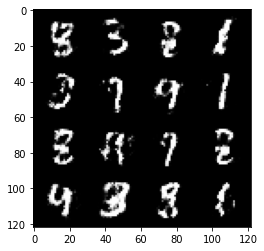

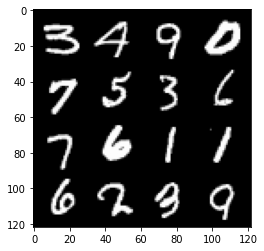

166: step 78000 / Gen_loss: 1.689778338670731 / Disc_loss: 0.7616725047429398


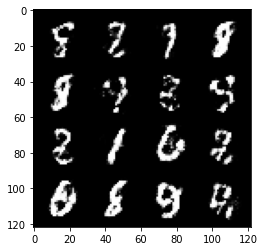

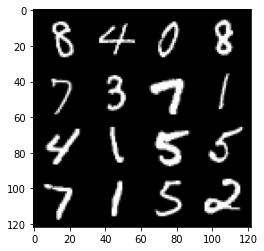

166: step 78300 / Gen_loss: 1.6784461116790756 / Disc_loss: 0.7439441082874931


  0%|          | 0/469 [00:00<?, ?it/s]

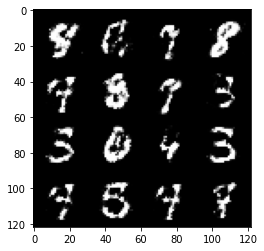

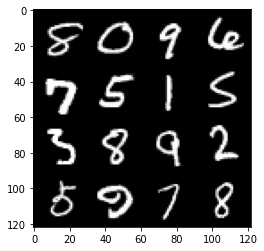

167: step 78600 / Gen_loss: 1.6412978219985956 / Disc_loss: 0.7838382099072132


  0%|          | 0/469 [00:00<?, ?it/s]

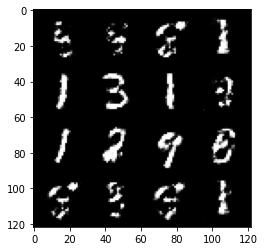

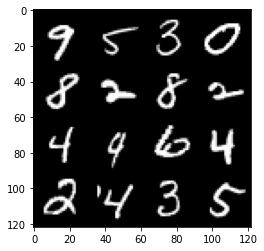

168: step 78900 / Gen_loss: 1.6568430030345922 / Disc_loss: 0.7684210906426111


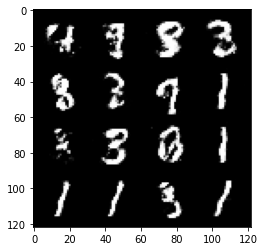

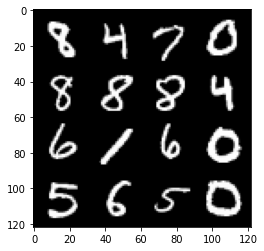

168: step 79200 / Gen_loss: 1.6263797291119886 / Disc_loss: 0.7577369087934498


  0%|          | 0/469 [00:00<?, ?it/s]

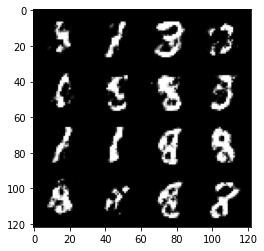

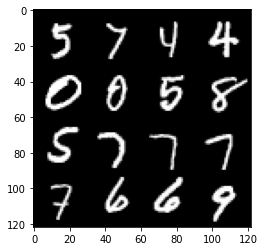

169: step 79500 / Gen_loss: 1.6323829666773484 / Disc_loss: 0.7391071460644404


  0%|          | 0/469 [00:00<?, ?it/s]

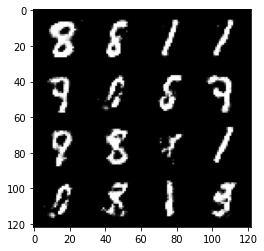

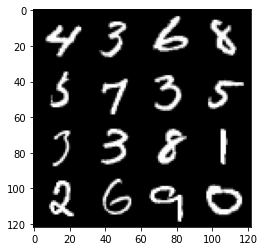

170: step 79800 / Gen_loss: 1.6584437076250715 / Disc_loss: 0.7609315651655197


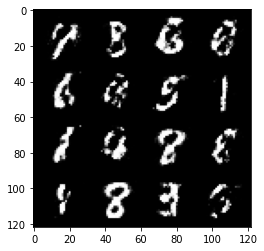

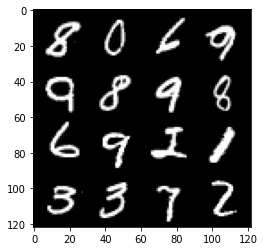

170: step 80100 / Gen_loss: 1.6836325526237486 / Disc_loss: 0.7287056706349054


  0%|          | 0/469 [00:00<?, ?it/s]

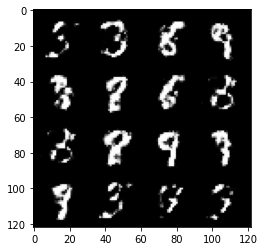

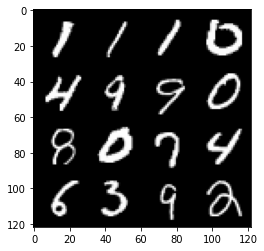

171: step 80400 / Gen_loss: 1.7219260438283286 / Disc_loss: 0.7114492744207385


  0%|          | 0/469 [00:00<?, ?it/s]

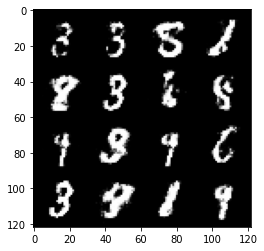

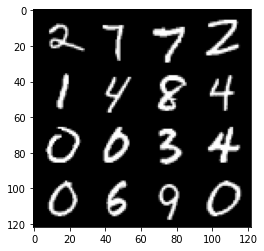

172: step 80700 / Gen_loss: 1.6905363615353897 / Disc_loss: 0.7737409128745399


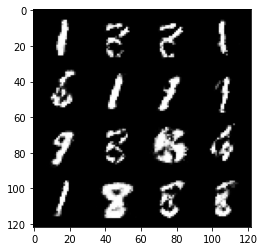

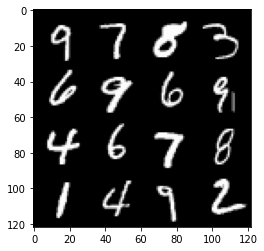

172: step 81000 / Gen_loss: 1.5958280996481577 / Disc_loss: 0.7935671295722325


  0%|          | 0/469 [00:00<?, ?it/s]

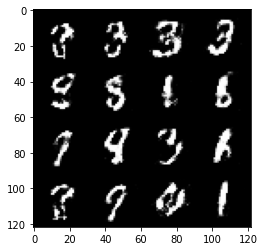

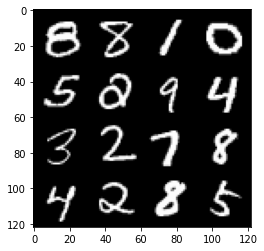

173: step 81300 / Gen_loss: 1.653874402840934 / Disc_loss: 0.7737405542532604


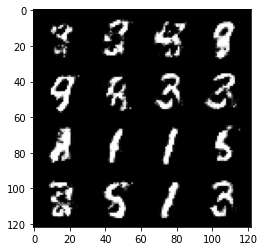

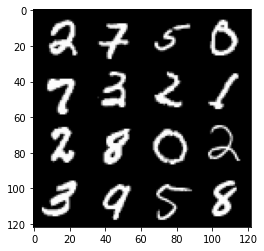

173: step 81600 / Gen_loss: 1.6515656399726857 / Disc_loss: 0.7601341956853862


  0%|          | 0/469 [00:00<?, ?it/s]

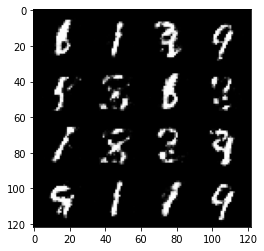

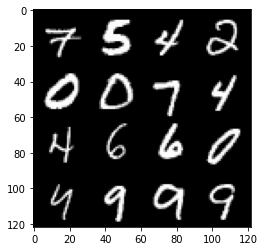

174: step 81900 / Gen_loss: 1.729356196721396 / Disc_loss: 0.7309241259098055


  0%|          | 0/469 [00:00<?, ?it/s]

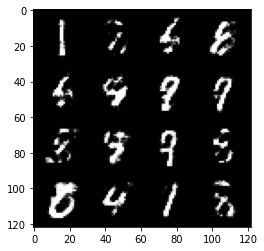

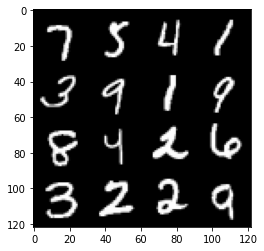

175: step 82200 / Gen_loss: 1.6363663045565295 / Disc_loss: 0.804584307074546


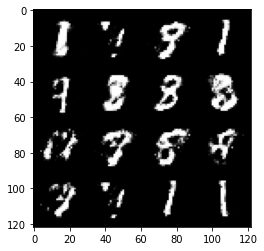

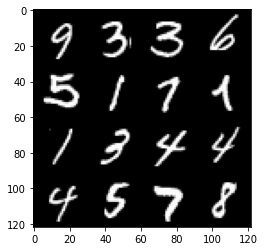

175: step 82500 / Gen_loss: 1.5963989468415583 / Disc_loss: 0.8156521274646126


  0%|          | 0/469 [00:00<?, ?it/s]

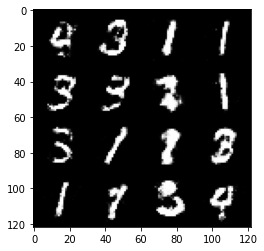

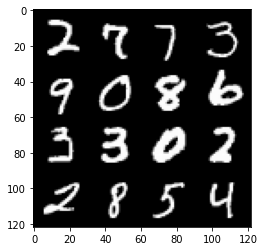

176: step 82800 / Gen_loss: 1.6284944534301748 / Disc_loss: 0.7681256494919462


  0%|          | 0/469 [00:00<?, ?it/s]

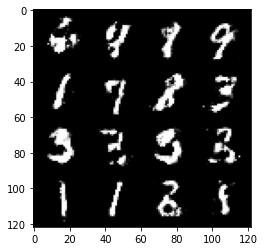

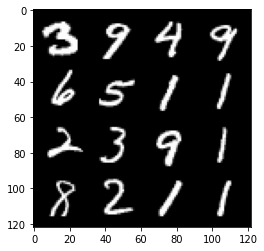

177: step 83100 / Gen_loss: 1.5886683988571182 / Disc_loss: 0.8136502675215399


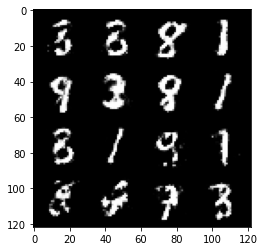

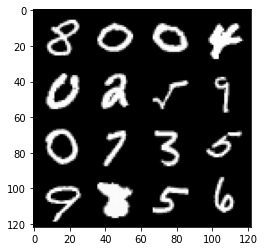

177: step 83400 / Gen_loss: 1.6391262932618444 / Disc_loss: 0.7863853152592976


  0%|          | 0/469 [00:00<?, ?it/s]

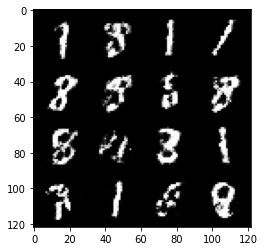

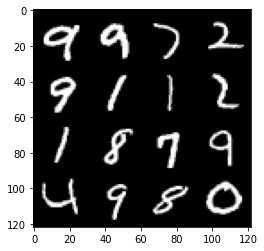

178: step 83700 / Gen_loss: 1.6948115122318268 / Disc_loss: 0.7358895230293262


  0%|          | 0/469 [00:00<?, ?it/s]

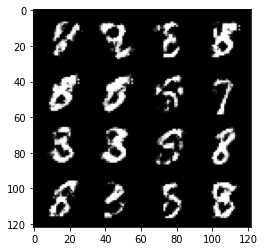

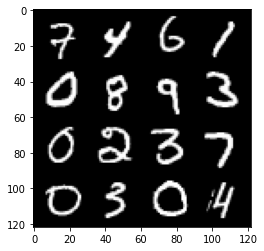

179: step 84000 / Gen_loss: 1.6935712377230323 / Disc_loss: 0.7582169278462726


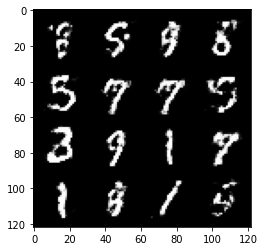

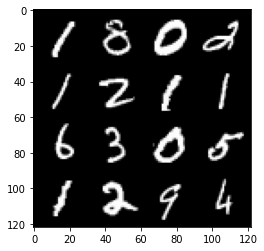

179: step 84300 / Gen_loss: 1.6862765725453692 / Disc_loss: 0.7673820394277572


  0%|          | 0/469 [00:00<?, ?it/s]

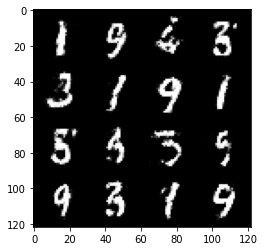

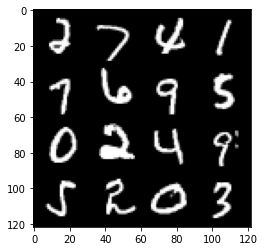

180: step 84600 / Gen_loss: 1.5535277060667687 / Disc_loss: 0.8376682539780943


  0%|          | 0/469 [00:00<?, ?it/s]

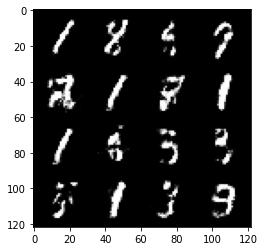

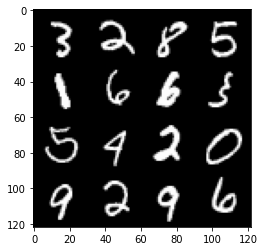

181: step 84900 / Gen_loss: 1.675481025377909 / Disc_loss: 0.752777474125226


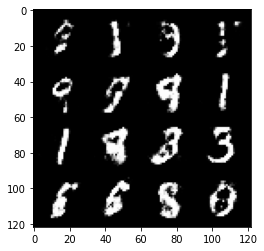

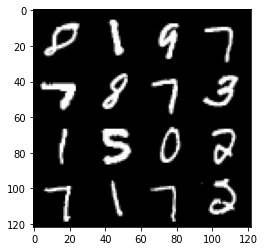

181: step 85200 / Gen_loss: 1.6386239639918005 / Disc_loss: 0.765317677855492


  0%|          | 0/469 [00:00<?, ?it/s]

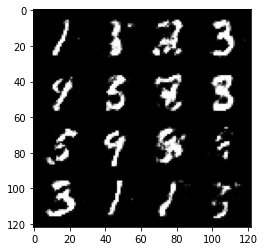

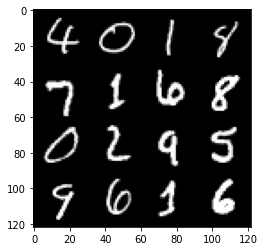

182: step 85500 / Gen_loss: 1.558031686941783 / Disc_loss: 0.8231874452034629


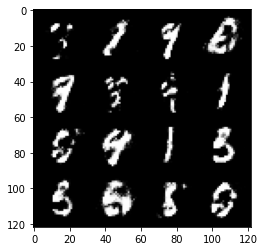

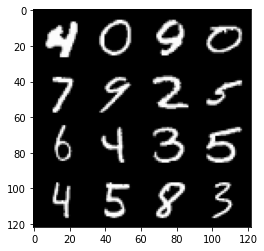

182: step 85800 / Gen_loss: 1.5605904702345534 / Disc_loss: 0.8169073444604876


  0%|          | 0/469 [00:00<?, ?it/s]

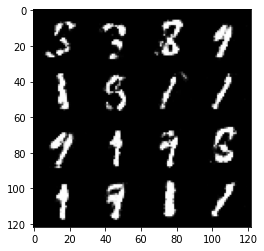

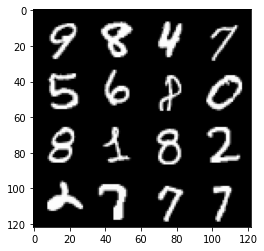

183: step 86100 / Gen_loss: 1.6176141643524176 / Disc_loss: 0.7837967807054519


  0%|          | 0/469 [00:00<?, ?it/s]

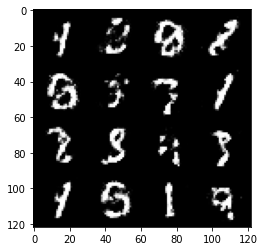

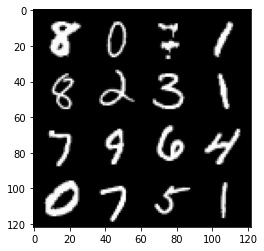

184: step 86400 / Gen_loss: 1.5687200315793355 / Disc_loss: 0.8134338251749677


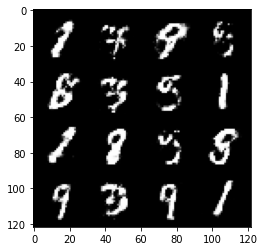

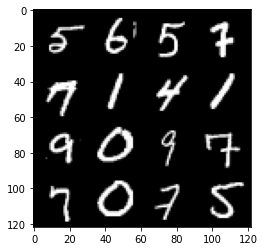

184: step 86700 / Gen_loss: 1.5726951173941293 / Disc_loss: 0.8144364545742675


  0%|          | 0/469 [00:00<?, ?it/s]

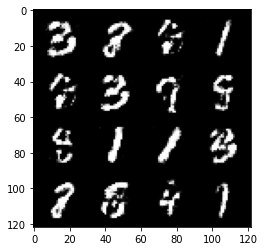

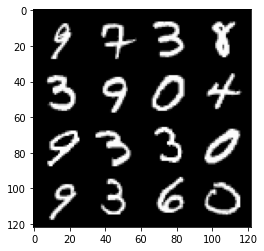

185: step 87000 / Gen_loss: 1.6051569020748135 / Disc_loss: 0.7878236383199693


  0%|          | 0/469 [00:00<?, ?it/s]

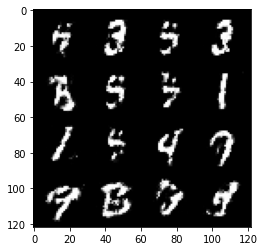

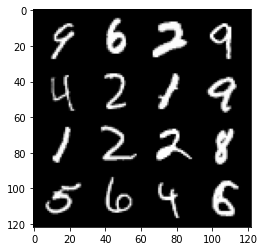

186: step 87300 / Gen_loss: 1.4952510352929438 / Disc_loss: 0.8618402427434918


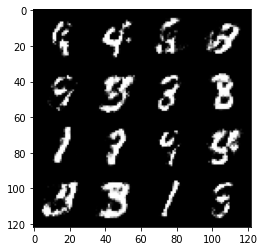

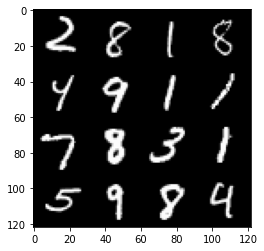

186: step 87600 / Gen_loss: 1.5499296744664517 / Disc_loss: 0.8059161895513537


  0%|          | 0/469 [00:00<?, ?it/s]

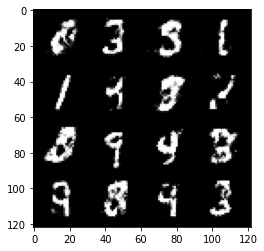

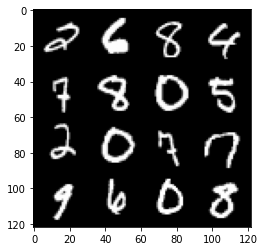

187: step 87900 / Gen_loss: 1.6295706160863248 / Disc_loss: 0.7621154433488845


  0%|          | 0/469 [00:00<?, ?it/s]

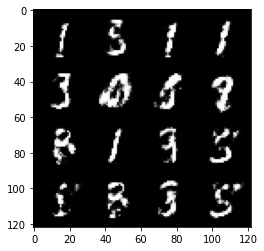

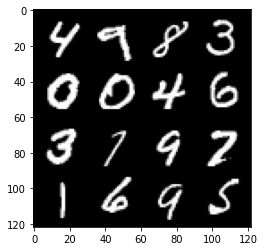

188: step 88200 / Gen_loss: 1.539542073408762 / Disc_loss: 0.814578318794568


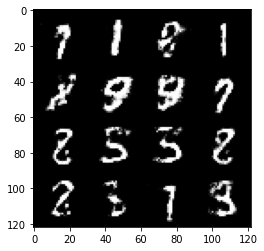

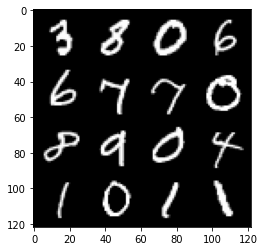

188: step 88500 / Gen_loss: 1.5672475604216256 / Disc_loss: 0.7869933267434441


  0%|          | 0/469 [00:00<?, ?it/s]

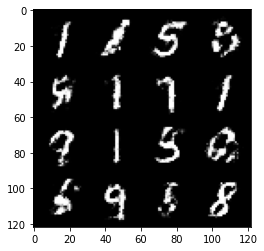

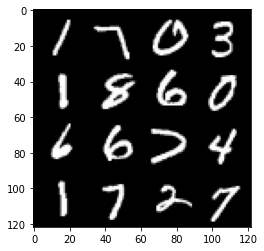

189: step 88800 / Gen_loss: 1.5720696445306148 / Disc_loss: 0.786014631787936


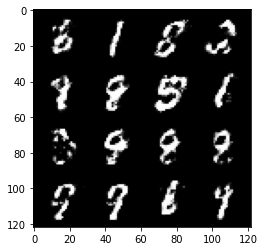

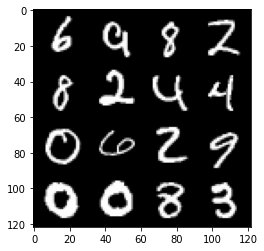

189: step 89100 / Gen_loss: 1.5506691801547992 / Disc_loss: 0.8090766366322835


  0%|          | 0/469 [00:00<?, ?it/s]

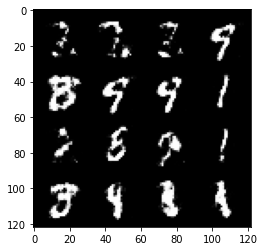

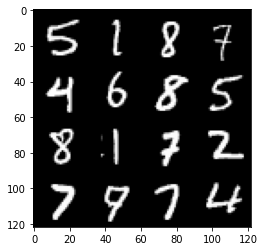

190: step 89400 / Gen_loss: 1.4981888377666488 / Disc_loss: 0.8130326920747759


  0%|          | 0/469 [00:00<?, ?it/s]

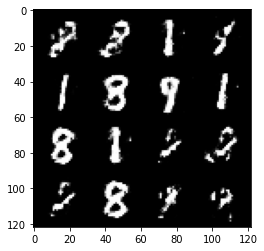

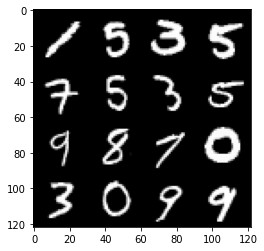

191: step 89700 / Gen_loss: 1.5704907699426018 / Disc_loss: 0.7592387090126679


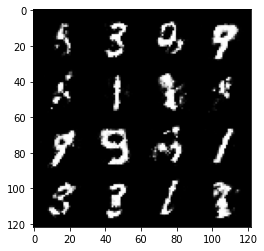

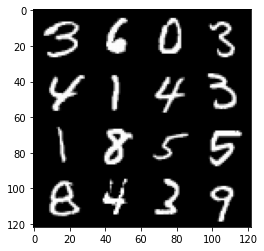

191: step 90000 / Gen_loss: 1.5916778258482622 / Disc_loss: 0.7665914473931


  0%|          | 0/469 [00:00<?, ?it/s]

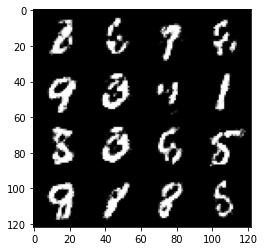

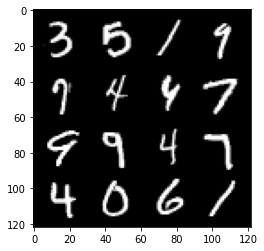

192: step 90300 / Gen_loss: 1.5461413403352104 / Disc_loss: 0.8035547510782873


  0%|          | 0/469 [00:00<?, ?it/s]

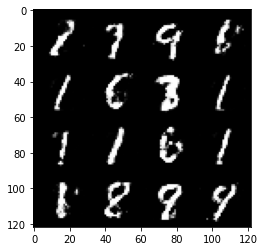

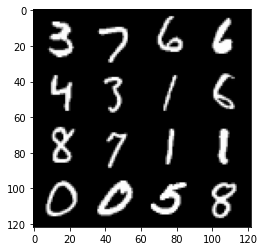

193: step 90600 / Gen_loss: 1.5167917998631786 / Disc_loss: 0.8375004923343652


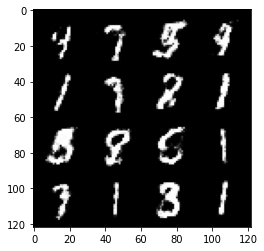

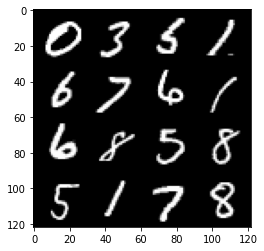

193: step 90900 / Gen_loss: 1.426476432085037 / Disc_loss: 0.8819798570871348


  0%|          | 0/469 [00:00<?, ?it/s]

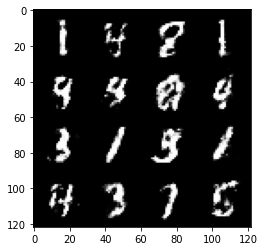

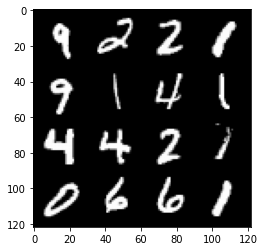

194: step 91200 / Gen_loss: 1.4977376461029062 / Disc_loss: 0.8205472475290294


  0%|          | 0/469 [00:00<?, ?it/s]

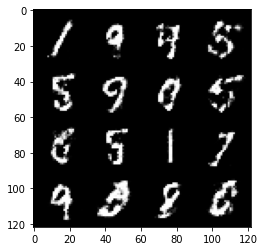

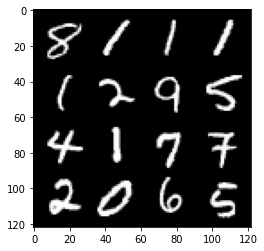

195: step 91500 / Gen_loss: 1.4541761704285927 / Disc_loss: 0.8515529312690099


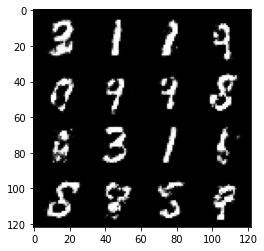

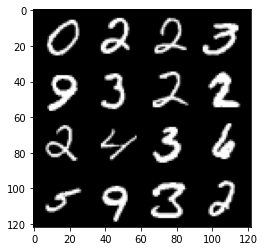

195: step 91800 / Gen_loss: 1.4237035143375394 / Disc_loss: 0.8849052623907727


  0%|          | 0/469 [00:00<?, ?it/s]

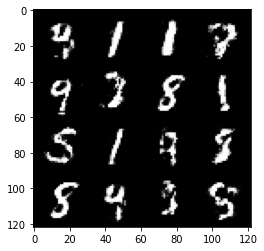

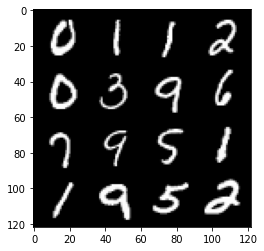

196: step 92100 / Gen_loss: 1.4477883509794867 / Disc_loss: 0.8629465301831563


  0%|          | 0/469 [00:00<?, ?it/s]

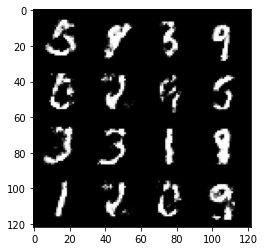

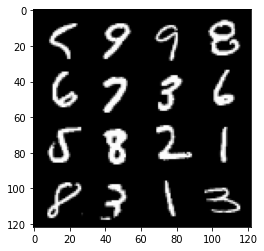

197: step 92400 / Gen_loss: 1.5124043774604792 / Disc_loss: 0.8628320725758871


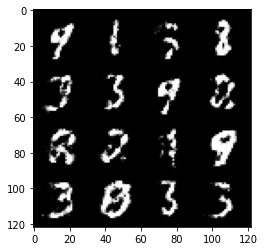

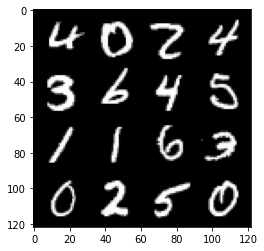

197: step 92700 / Gen_loss: 1.4631536483764647 / Disc_loss: 0.8449982444445292


  0%|          | 0/469 [00:00<?, ?it/s]

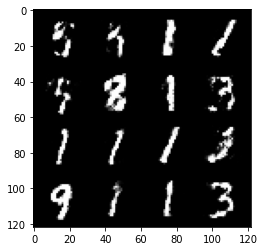

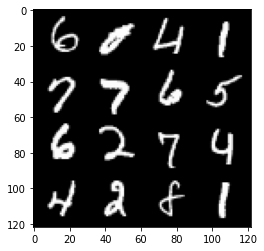

198: step 93000 / Gen_loss: 1.6253658640384672 / Disc_loss: 0.7395478806893024


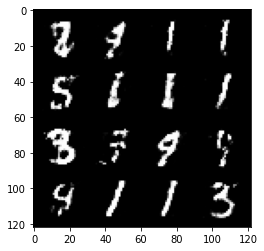

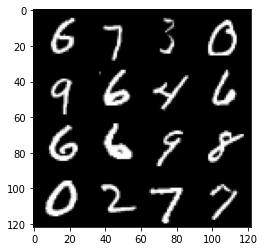

198: step 93300 / Gen_loss: 1.5571149361133565 / Disc_loss: 0.8058585764964421


  0%|          | 0/469 [00:00<?, ?it/s]

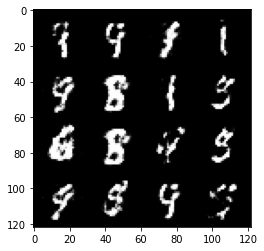

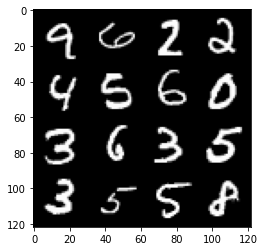

199: step 93600 / Gen_loss: 1.4540646318594617 / Disc_loss: 0.8275874102115632


  0%|          | 0/469 [00:00<?, ?it/s]

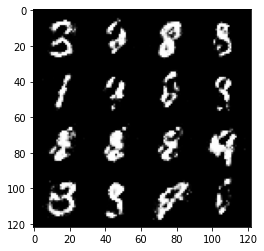

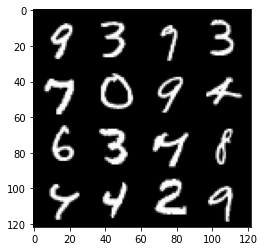

200: step 93900 / Gen_loss: 1.4622811830043791 / Disc_loss: 0.8205847630898166


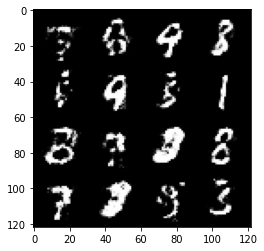

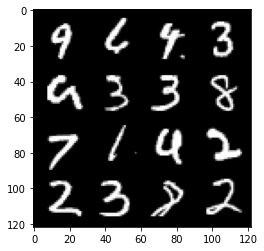

200: step 94200 / Gen_loss: 1.5230124954382591 / Disc_loss: 0.803447290857633


  0%|          | 0/469 [00:00<?, ?it/s]

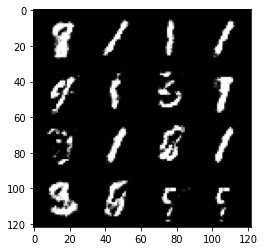

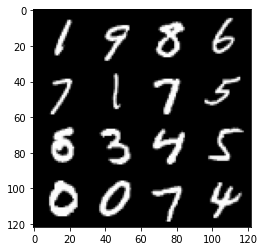

201: step 94500 / Gen_loss: 1.3686673192183176 / Disc_loss: 0.9041996747255326


  0%|          | 0/469 [00:00<?, ?it/s]

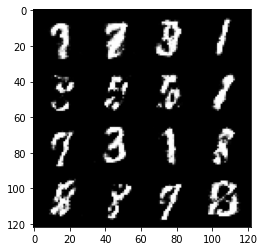

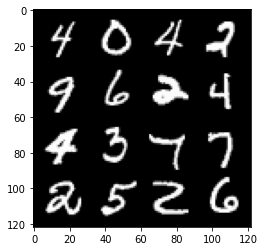

202: step 94800 / Gen_loss: 1.4035594987869255 / Disc_loss: 0.8754519180456796


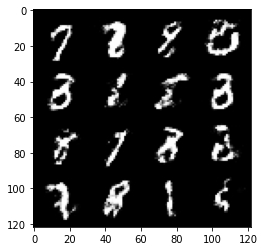

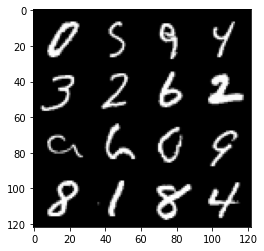

202: step 95100 / Gen_loss: 1.4190521140893293 / Disc_loss: 0.8603182882070536


  0%|          | 0/469 [00:00<?, ?it/s]

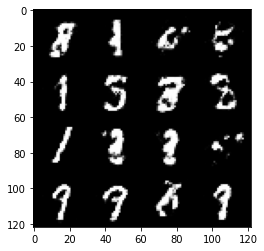

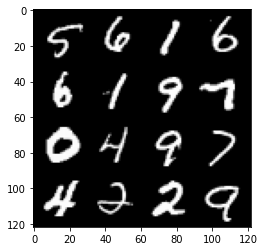

203: step 95400 / Gen_loss: 1.4437896529833476 / Disc_loss: 0.8469193444649374


  0%|          | 0/469 [00:00<?, ?it/s]

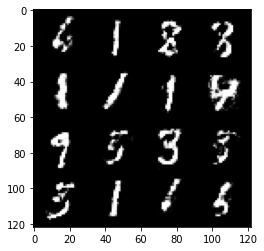

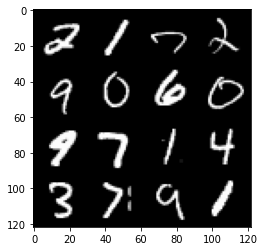

204: step 95700 / Gen_loss: 1.4591971941789013 / Disc_loss: 0.8321998735268912


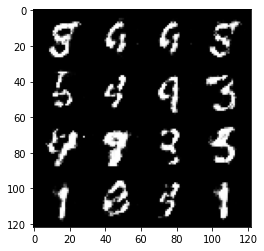

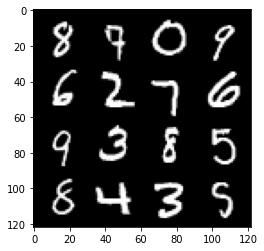

204: step 96000 / Gen_loss: 1.486843790213267 / Disc_loss: 0.8184436678886412


  0%|          | 0/469 [00:00<?, ?it/s]

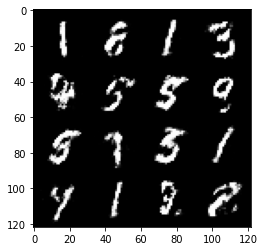

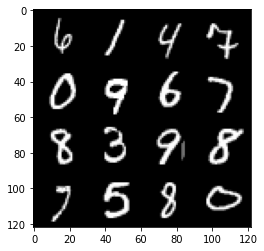

205: step 96300 / Gen_loss: 1.4878275632858282 / Disc_loss: 0.8249992289145789


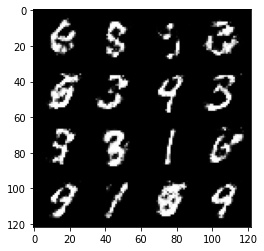

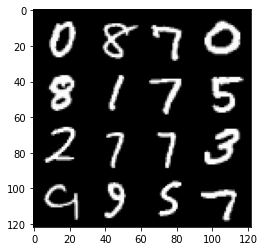

205: step 96600 / Gen_loss: 1.4433291149139404 / Disc_loss: 0.8510810607671746


  0%|          | 0/469 [00:00<?, ?it/s]

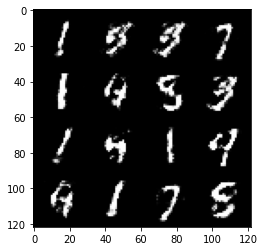

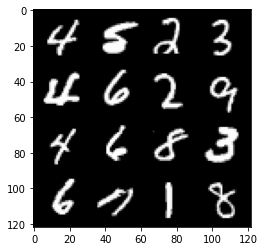

206: step 96900 / Gen_loss: 1.4735649979114536 / Disc_loss: 0.829660807847977


  0%|          | 0/469 [00:00<?, ?it/s]

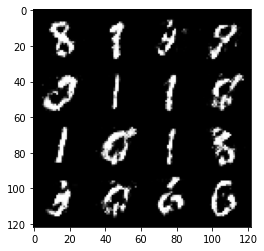

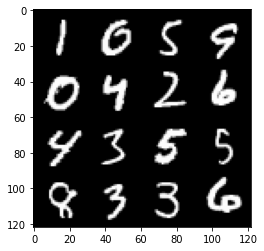

207: step 97200 / Gen_loss: 1.433856407006583 / Disc_loss: 0.8661520342032115


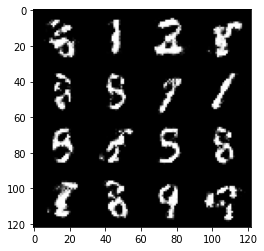

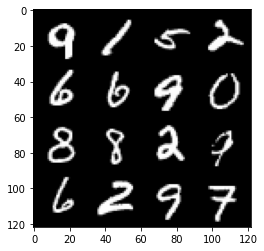

207: step 97500 / Gen_loss: 1.4890328601996092 / Disc_loss: 0.8217228271563849


  0%|          | 0/469 [00:00<?, ?it/s]

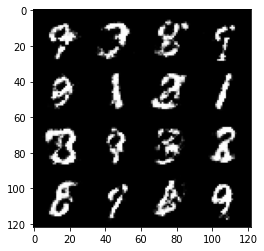

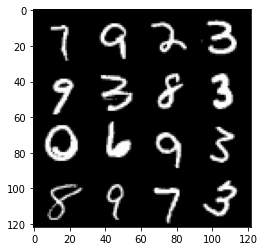

208: step 97800 / Gen_loss: 1.4680233196417483 / Disc_loss: 0.8417899278799699


  0%|          | 0/469 [00:00<?, ?it/s]

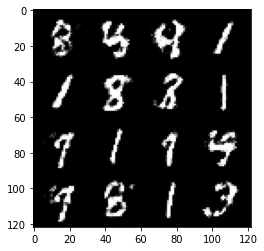

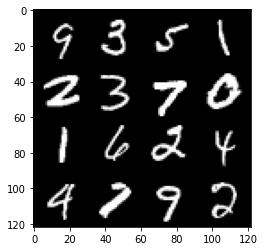

209: step 98100 / Gen_loss: 1.4486865770816804 / Disc_loss: 0.8471453581253682


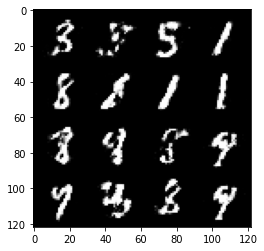

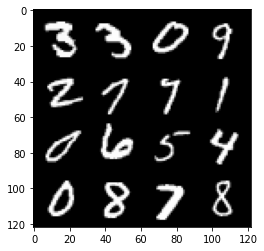

209: step 98400 / Gen_loss: 1.4498726499080672 / Disc_loss: 0.8503310944636661


  0%|          | 0/469 [00:00<?, ?it/s]

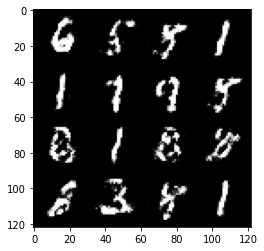

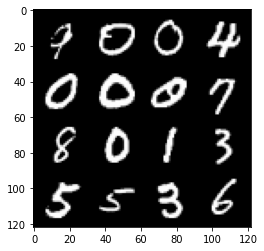

210: step 98700 / Gen_loss: 1.438612277110417 / Disc_loss: 0.849562432964642


  0%|          | 0/469 [00:00<?, ?it/s]

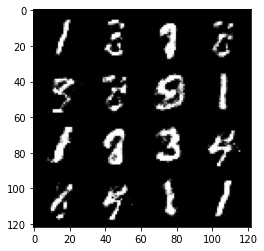

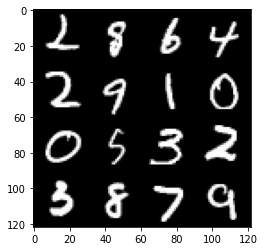

211: step 99000 / Gen_loss: 1.4233725114663445 / Disc_loss: 0.8677428048849102


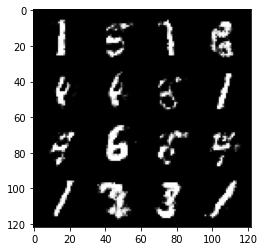

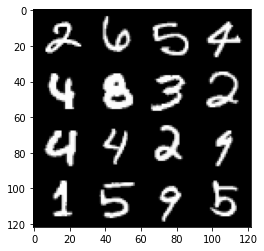

211: step 99300 / Gen_loss: 1.4325538921356198 / Disc_loss: 0.8559396366278329


  0%|          | 0/469 [00:00<?, ?it/s]

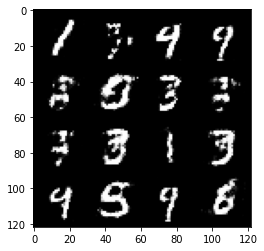

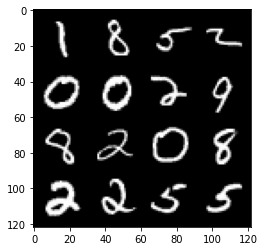

212: step 99600 / Gen_loss: 1.3779136935869851 / Disc_loss: 0.8902011183897652


  0%|          | 0/469 [00:00<?, ?it/s]

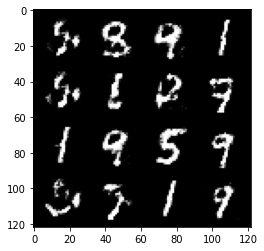

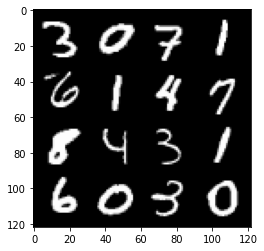

213: step 99900 / Gen_loss: 1.3427313331762945 / Disc_loss: 0.906855773329735


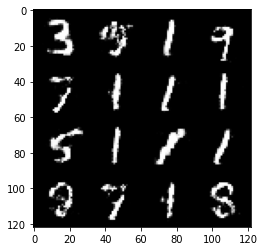

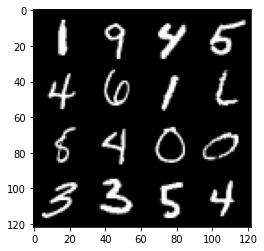

213: step 100200 / Gen_loss: 1.261610087156295 / Disc_loss: 0.960317754348119


  0%|          | 0/469 [00:00<?, ?it/s]

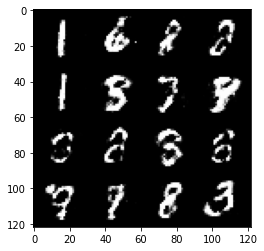

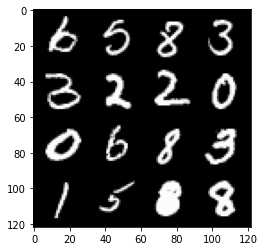

214: step 100500 / Gen_loss: 1.369685763120652 / Disc_loss: 0.8799726206064226


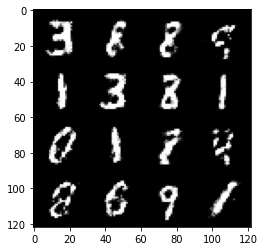

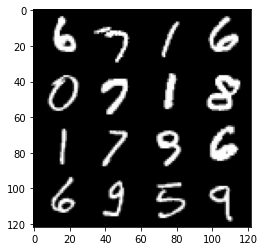

214: step 100800 / Gen_loss: 1.39693627635638 / Disc_loss: 0.8915915131568909


  0%|          | 0/469 [00:00<?, ?it/s]

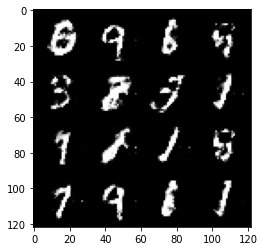

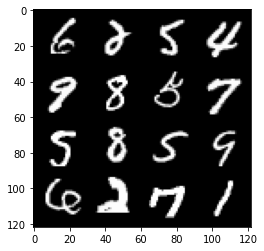

215: step 101100 / Gen_loss: 1.3837184369564062 / Disc_loss: 0.8877325036128363


  0%|          | 0/469 [00:00<?, ?it/s]

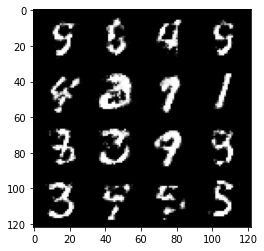

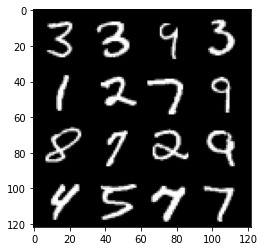

216: step 101400 / Gen_loss: 1.3046551378568019 / Disc_loss: 0.9219280451536174


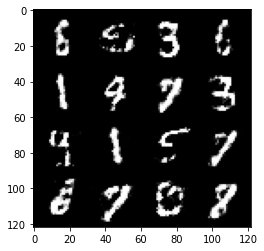

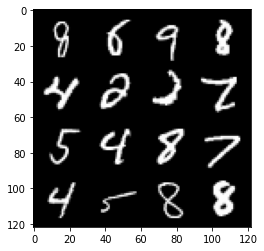

216: step 101700 / Gen_loss: 1.3290997934341426 / Disc_loss: 0.9030222165584573


  0%|          | 0/469 [00:00<?, ?it/s]

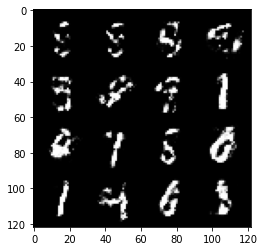

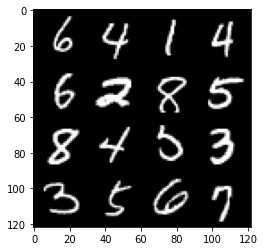

217: step 102000 / Gen_loss: 1.36710151274999 / Disc_loss: 0.8837165218591695


  0%|          | 0/469 [00:00<?, ?it/s]

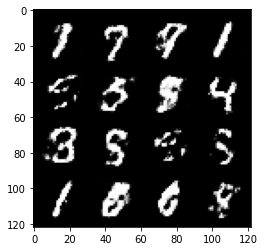

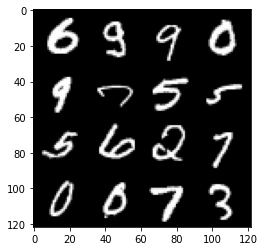

218: step 102300 / Gen_loss: 1.3365827711423253 / Disc_loss: 0.8843797934055331


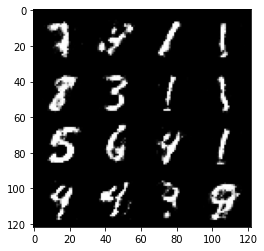

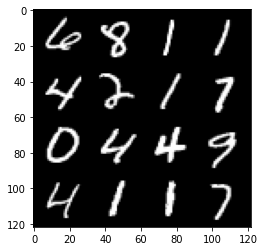

218: step 102600 / Gen_loss: 1.3403577840328211 / Disc_loss: 0.9016321978966397


  0%|          | 0/469 [00:00<?, ?it/s]

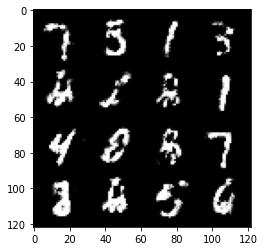

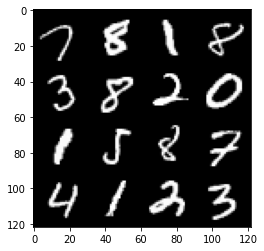

219: step 102900 / Gen_loss: 1.2579707594712575 / Disc_loss: 0.9422130485375715


  0%|          | 0/469 [00:00<?, ?it/s]

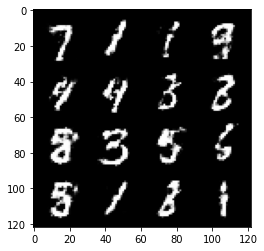

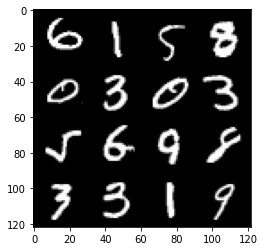

220: step 103200 / Gen_loss: 1.2452881813049324 / Disc_loss: 0.9528172326087953


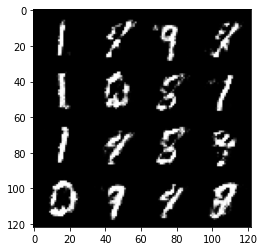

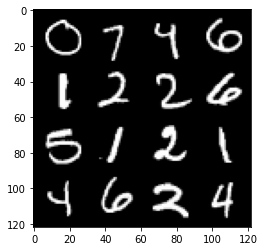

220: step 103500 / Gen_loss: 1.3165820002555857 / Disc_loss: 0.913672738075256


  0%|          | 0/469 [00:00<?, ?it/s]

In [ ]:
### 60000 mnist images

for epoch in range(epochs):
  for real,_ in tqdm(dataloader):
    #### discriminator
    disc_opt.zero_grad()
    cur_bs = len(real)
    real = real.view(cur_bs,-1)
    real = real.to(device)
    disc_loss = calc_disc_loss(loss_func,gen,disc,cur_bs,real,z_dim)
    disc_loss.backward(retain_graph=True)
    disc_opt.step()

    #### generator
    gen_opt.zero_grad()
    gen_loss = calc_gen_loss(loss_func,gen,disc,cur_bs,z_dim)
    gen_loss.backward(retain_graph=True)
    gen_opt.step()

    #### Visualization and stats
    mean_disc_loss +=  disc_loss.item()/info_step
    mean_gen_loss +=  gen_loss.item()/info_step
    if (cur_step % info_step == 0 )and (cur_step>0):
      fake_noise = gen_noise(cur_bs,z_dim)
      fake = gen(fake_noise)
      show(fake)
      show(real)
      print(f"{epoch}: step {cur_step} / Gen_loss: {mean_gen_loss} / Disc_loss: {mean_disc_loss}")
      mean_gen_loss,mean_disc_loss = 0,0
    cur_step +=1

